<a href="https://colab.research.google.com/github/rakaganguli/AQI_Thesis/blob/main/THESIS__AQI_(1).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [55]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All"
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

ACCESSING DATA FROM GOOGLE DRIVE

EXPLANATION BELOW:

1.from google.colab import drive: This line imports the drive module from the google.colab library. Google Colab provides this library to interact with Google Drive.

2.drive.mount("/content/drive"): This line mounts Google Drive in the Colab environment. After running this line, we'll be prompted to enter an authentication code to allow Colab to access our Google Drive.

3.!pwd: This line is a shell command executed using the ! prefix in Colab. It prints the current working directory in the Colab environment.

4.!ls /content/drive/MyDrive/city_hour[1].csv: This line lists the files in the directory specified by the path /content/drive/MyDrive/city_hour[1].csv. The square brackets [1] are used for shell expansion, which means it will match any single character inside the brackets. So, this command lists files matching the pattern city_hour1.csv in the specified directory.








In [56]:
from google.colab import drive
drive.mount("/content/drive")

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [57]:
!pwd

/content


In [58]:
!ls /content/drive/MyDrive/city_day.csv

/content/drive/MyDrive/city_day.csv


In [59]:
import pandas as pd
from sklearn.impute import SimpleImputer
from imblearn.over_sampling import SMOTE
from sklearn.preprocessing import LabelEncoder
import os                          # operating system interfaces
import glob                        # working with OS pathnames
import time                        # time processing
import numpy as np                 # linear algebra
import pandas as pd                # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt    # data visualization purposes
import seaborn as sns              # statistical data visualization



In [60]:
df = pd.read_csv('/content/drive/MyDrive/city_day.csv')
df

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,Ahmedabad,2015-01-01,NaN,NaN,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.00,0.02,0.00,NaN,NaN
1,Ahmedabad,2015-01-02,NaN,NaN,0.97,15.69,16.46,NaN,0.97,24.55,34.06,3.68,5.50,3.77,NaN,NaN
2,Ahmedabad,2015-01-03,NaN,NaN,17.40,19.30,29.70,NaN,17.40,29.07,30.70,6.80,16.40,2.25,NaN,NaN
3,Ahmedabad,2015-01-04,NaN,NaN,1.70,18.48,17.97,NaN,1.70,18.59,36.08,4.43,10.14,1.00,NaN,NaN
4,Ahmedabad,2015-01-05,NaN,NaN,22.10,21.42,37.76,NaN,22.10,39.33,39.31,7.01,18.89,2.78,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29526,Visakhapatnam,2020-06-27,15.02,50.94,7.68,25.06,19.54,12.47,0.47,8.55,23.30,2.24,12.07,0.73,41.0,Good
29527,Visakhapatnam,2020-06-28,24.38,74.09,3.42,26.06,16.53,11.99,0.52,12.72,30.14,0.74,2.21,0.38,70.0,Satisfactory
29528,Visakhapatnam,2020-06-29,22.91,65.73,3.45,29.53,18.33,10.71,0.48,8.42,30.96,0.01,0.01,0.00,68.0,Satisfactory
29529,Visakhapatnam,2020-06-30,16.64,49.97,4.05,29.26,18.80,10.03,0.52,9.84,28.30,0.00,0.00,0.00,54.0,Satisfactory


DEMONSTRATES THE NUMBER OF ROWS AND COLUMNS

In [61]:
df.shape

(29531, 16)

In [62]:
df['City'].unique()

array(['Ahmedabad', 'Aizawl', 'Amaravati', 'Amritsar', 'Bengaluru',
       'Bhopal', 'Brajrajnagar', 'Chandigarh', 'Chennai', 'Coimbatore',
       'Delhi', 'Ernakulam', 'Gurugram', 'Guwahati', 'Hyderabad',
       'Jaipur', 'Jorapokhar', 'Kochi', 'Kolkata', 'Lucknow', 'Mumbai',
       'Patna', 'Shillong', 'Talcher', 'Thiruvananthapuram',
       'Visakhapatnam'], dtype=object)

TOTAL NUMBER OF CITIES IN THE DATAFRAME

In [63]:
unique_cities = df['City'].unique()
total_unique_cities = len(unique_cities)
total_unique_cities

26

The below code returns a Series object containing the total number of missing values in each column of the DataFrame 'df'.

In [64]:
df.isnull().sum()


City              0
Date              0
PM2.5          4598
PM10          11140
NO             3582
NO2            3585
NOx            4185
NH3           10328
CO             2059
SO2            3854
O3             4022
Benzene        5623
Toluene        8041
Xylene        18109
AQI            4681
AQI_Bucket     4681
dtype: int64

CALCULATING THE PERCENTAGE OF MISSING VALUES IN DESCENDING ORDER

In [65]:
# Calculate the total number of missing values in each column
missing_values = df.isnull().sum()

# Calculate the total number of entries in the DataFrame
total_entries = df.shape[0]

# Calculate the percentage of missing values in each column
missing_percentage = (missing_values / total_entries) * 100

# Sort the missing_percentage Series in descending order
missing_percentage_sorted = missing_percentage.sort_values(ascending=False)

# Display the result
print("Percentage of missing values in each column (descending order):")
print(missing_percentage_sorted)


Percentage of missing values in each column (descending order):
Xylene        61.322001
PM10          37.723071
NH3           34.973418
Toluene       27.229014
Benzene       19.041008
AQI           15.851139
AQI_Bucket    15.851139
PM2.5         15.570079
NOx           14.171549
O3            13.619586
SO2           13.050692
NO2           12.139785
NO            12.129626
CO             6.972334
City           0.000000
Date           0.000000
dtype: float64


VISUALIZATION OF MISSING VALUES PERCENTAGE

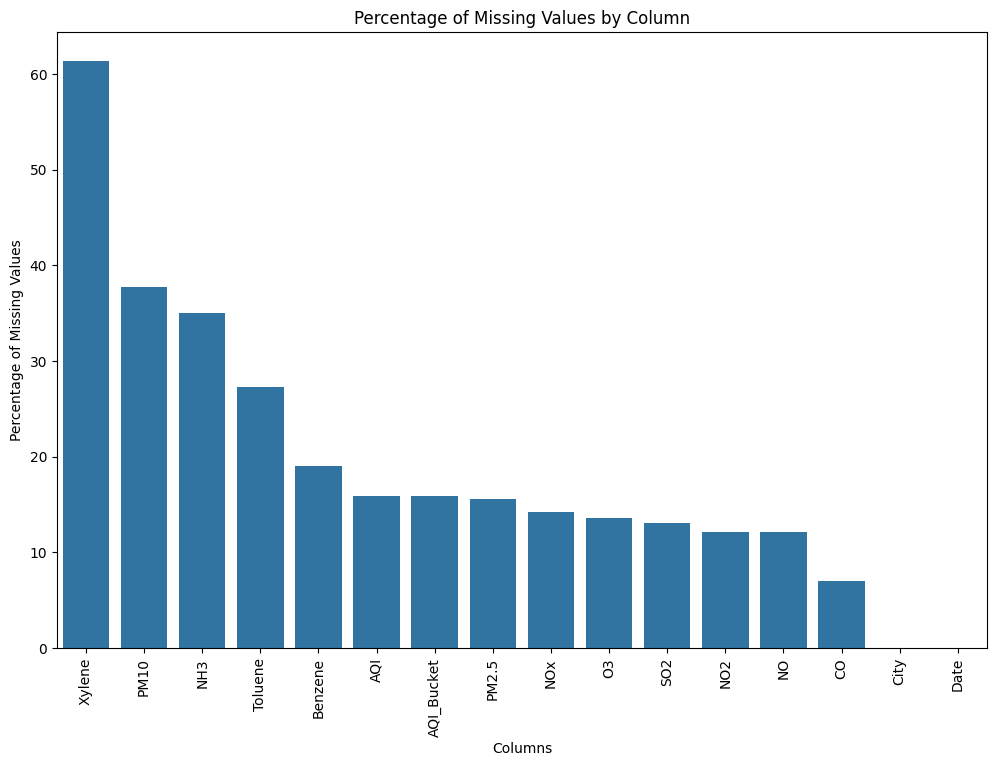

In [66]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

# Calculate the total number of missing values in each column
missing_values = df.isnull().sum()

# Calculate the total number of entries in the DataFrame
total_entries = df.shape[0]

# Calculate the percentage of missing values in each column
missing_percentage = (missing_values / total_entries) * 100

# Sort the missing_percentage Series in descending order
missing_percentage_sorted = missing_percentage.sort_values(ascending=False)

# Visualize the missing percentages using a bar graph
plt.figure(figsize=(12, 8))
sns.barplot(x=missing_percentage_sorted.index, y=missing_percentage_sorted.values)
plt.xticks(rotation=90)
plt.xlabel('Columns')
plt.ylabel('Percentage of Missing Values')
plt.title('Percentage of Missing Values by Column')
plt.show()


IMPORTING NECESSARY PACKAGES AND LIBRARIES

In [67]:
import pandas as pd
import os
import zipfile
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.graph_objs as go
import numpy as np
from plotly.offline import init_notebook_mode,iplot
import missingno as msno
from sklearn.impute import KNNImputer
from sklearn import preprocessing
import pylab
import scipy.stats as stats
from scipy.special import boxcox1p
import pylab
import scipy.stats as stats
%matplotlib inline
# Transformation and modelling packages
from sklearn.model_selection import train_test_split , KFold
from sklearn.metrics import accuracy_score
from sklearn. preprocessing import StandardScaler
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
from sklearn.naive_bayes import BernoulliNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from xgboost import XGBClassifier
from collections import Counter
from sklearn.model_selection import GridSearchCV ,RandomizedSearchCV
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn import metrics
from sklearn.model_selection import cross_val_score
from sklearn.svm import SVC

By executing the below line of code, the values in the 'Datetime' column, which may have been in different formats (e.g., strings, objects), are converted to datetime objects. This makes it easier to work with dates and times in subsequent analysis or visualization tasks.








In [68]:
df['Date'] = pd.to_datetime(df['Date'])

In [69]:
df.head()

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,Ahmedabad,2015-01-01,NaN,NaN,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.00,0.02,0.00,NaN,NaN
1,Ahmedabad,2015-01-02,NaN,NaN,0.97,15.69,16.46,NaN,0.97,24.55,34.06,3.68,5.50,3.77,NaN,NaN
2,Ahmedabad,2015-01-03,NaN,NaN,17.40,19.30,29.70,NaN,17.40,29.07,30.70,6.80,16.40,2.25,NaN,NaN
3,Ahmedabad,2015-01-04,NaN,NaN,1.70,18.48,17.97,NaN,1.70,18.59,36.08,4.43,10.14,1.00,NaN,NaN
4,Ahmedabad,2015-01-05,NaN,NaN,22.10,21.42,37.76,NaN,22.10,39.33,39.31,7.01,18.89,2.78,NaN,NaN


In [70]:
df.tail()

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
29526,Visakhapatnam,2020-06-27,15.02,50.94,7.68,25.06,19.54,12.47,0.47,8.55,23.30,2.24,12.07,0.73,41.0,Good
29527,Visakhapatnam,2020-06-28,24.38,74.09,3.42,26.06,16.53,11.99,0.52,12.72,30.14,0.74,2.21,0.38,70.0,Satisfactory
29528,Visakhapatnam,2020-06-29,22.91,65.73,3.45,29.53,18.33,10.71,0.48,8.42,30.96,0.01,0.01,0.00,68.0,Satisfactory
29529,Visakhapatnam,2020-06-30,16.64,49.97,4.05,29.26,18.80,10.03,0.52,9.84,28.30,0.00,0.00,0.00,54.0,Satisfactory
29530,Visakhapatnam,2020-07-01,15.00,66.00,0.40,26.85,14.05,5.20,0.59,2.10,17.05,NaN,NaN,NaN,50.0,Good


In [71]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29531 entries, 0 to 29530
Data columns (total 16 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   City        29531 non-null  object        
 1   Date        29531 non-null  datetime64[ns]
 2   PM2.5       24933 non-null  float64       
 3   PM10        18391 non-null  float64       
 4   NO          25949 non-null  float64       
 5   NO2         25946 non-null  float64       
 6   NOx         25346 non-null  float64       
 7   NH3         19203 non-null  float64       
 8   CO          27472 non-null  float64       
 9   SO2         25677 non-null  float64       
 10  O3          25509 non-null  float64       
 11  Benzene     23908 non-null  float64       
 12  Toluene     21490 non-null  float64       
 13  Xylene      11422 non-null  float64       
 14  AQI         24850 non-null  float64       
 15  AQI_Bucket  24850 non-null  object        
dtypes: datetime64[ns](1), 

CREATING A COPY OF THE ORIGINAL DATAFRAME 'df' AND USING MAPPING FUNCTION TO CONVERT CATEGORICAL DATA OF AQI_Bucket TO NUMERICAL VALUES

In [72]:
import pandas as pd


# Create a copy of the DataFrame
df_copy = df.copy()

# Check unique values in the 'AQI_Bucket' column before mapping
print("Unique values in 'AQI_Bucket' before mapping:", df_copy['AQI_Bucket'].unique())

# Map categorical values in 'AQI_Bucket' to numerical values
df_copy['AQI_Bucket'] = df_copy['AQI_Bucket'].map({
    'Good': 0,
    'Satisfactory': 1,
    'Moderate': 2,
    'Poor': 3,
    'Very Poor': 4,
    'Severe': 5
})

# Check unique values in the 'AQI_Bucket' column after mapping
print("Unique values in 'AQI_Bucket' after mapping:", df_copy['AQI_Bucket'].unique())


Unique values in 'AQI_Bucket' before mapping: [nan 'Poor' 'Very Poor' 'Severe' 'Moderate' 'Satisfactory' 'Good']
Unique values in 'AQI_Bucket' after mapping: [nan  3.  4.  5.  2.  1.  0.]


CHECKING THE STATISTICAL METRICS OF THE DATAFRAME

In [73]:
df.describe()

,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI
count,29531,24933.000000,18391.000000,25949.000000,25946.000000,25346.000000,19203.000000,27472.000000,25677.000000,25509.000000,23908.000000,21490.000000,11422.000000,24850.000000
mean,2018-05-14 05:40:15.807118080,67.450578,118.127103,17.574730,28.560659,32.309123,23.483476,2.248598,14.531977,34.491430,3.280840,8.700972,3.070128,166.463581
min,2015-01-01 00:00:00,0.040000,0.010000,0.020000,0.010000,0.000000,0.010000,0.000000,0.010000,0.010000,0.000000,0.000000,0.000000,13.000000
25%,2017-04-16 00:00:00,28.820000,56.255000,5.630000,11.750000,12.820000,8.580000,0.510000,5.670000,18.860000,0.120000,0.600000,0.140000,81.000000
50%,2018-08-05 00:00:00,48.570000,95.680000,9.890000,21.690000,23.520000,15.850000,0.890000,9.160000,30.840000,1.070000,2.970000,0.980000,118.000000
75%,2019-09-03 00:00:00,80.590000,149.745000,19.950000,37.620000,40.127500,30.020000,1.450000,15.220000,45.570000,3.080000,9.150000,3.350000,208.000000
max,2020-07-01 00:00:00,949.990000,1000.000000,390.680000,362.210000,467.630000,352.890000,175.810000,193.860000,257.730000,455.030000,454.850000,170.370000,2049.000000
std,NaN,64.661449,90.605110,22.785846,24.474746,31.646011,25.684275,6.962884,18.133775,21.694928,15.811136,19.969164,6.323247,140.696585


CHECKING STATISTICAL FEATURES OF THE DATAFRAME 'df_copy' AFTER MAPPING AQI_Bucket

In [74]:
df_copy.describe()

,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
count,29531,24933.000000,18391.000000,25949.000000,25946.000000,25346.000000,19203.000000,27472.000000,25677.000000,25509.000000,23908.000000,21490.000000,11422.000000,24850.000000,24850.000000
mean,2018-05-14 05:40:15.807118080,67.450578,118.127103,17.574730,28.560659,32.309123,23.483476,2.248598,14.531977,34.491430,3.280840,8.700972,3.070128,166.463581,2.022656
min,2015-01-01 00:00:00,0.040000,0.010000,0.020000,0.010000,0.000000,0.010000,0.000000,0.010000,0.010000,0.000000,0.000000,0.000000,13.000000,0.000000
25%,2017-04-16 00:00:00,28.820000,56.255000,5.630000,11.750000,12.820000,8.580000,0.510000,5.670000,18.860000,0.120000,0.600000,0.140000,81.000000,1.000000
50%,2018-08-05 00:00:00,48.570000,95.680000,9.890000,21.690000,23.520000,15.850000,0.890000,9.160000,30.840000,1.070000,2.970000,0.980000,118.000000,2.000000
75%,2019-09-03 00:00:00,80.590000,149.745000,19.950000,37.620000,40.127500,30.020000,1.450000,15.220000,45.570000,3.080000,9.150000,3.350000,208.000000,3.000000
max,2020-07-01 00:00:00,949.990000,1000.000000,390.680000,362.210000,467.630000,352.890000,175.810000,193.860000,257.730000,455.030000,454.850000,170.370000,2049.000000,5.000000
std,NaN,64.661449,90.605110,22.785846,24.474746,31.646011,25.684275,6.962884,18.133775,21.694928,15.811136,19.969164,6.323247,140.696585,1.232487


CHECKING INFO OF DATA TYPES IN 'df_copy'

In [75]:
df_copy.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29531 entries, 0 to 29530
Data columns (total 16 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   City        29531 non-null  object        
 1   Date        29531 non-null  datetime64[ns]
 2   PM2.5       24933 non-null  float64       
 3   PM10        18391 non-null  float64       
 4   NO          25949 non-null  float64       
 5   NO2         25946 non-null  float64       
 6   NOx         25346 non-null  float64       
 7   NH3         19203 non-null  float64       
 8   CO          27472 non-null  float64       
 9   SO2         25677 non-null  float64       
 10  O3          25509 non-null  float64       
 11  Benzene     23908 non-null  float64       
 12  Toluene     21490 non-null  float64       
 13  Xylene      11422 non-null  float64       
 14  AQI         24850 non-null  float64       
 15  AQI_Bucket  24850 non-null  float64       
dtypes: datetime64[ns](1), 

KDE PLOT OF ALL NUMERIC COLUMNS IN 'df_copy' (THIS INCLUDES THE AQI_Bucket)

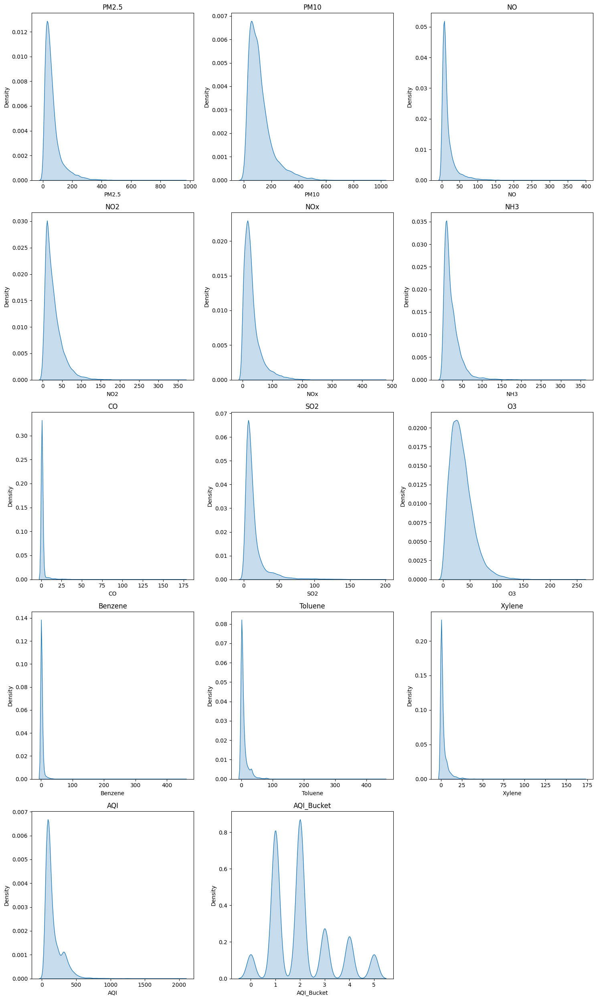

In [76]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt


# Drop the 'Datetime' column if present (since KDE plot is not applicable for datetime data)
if 'Datetime' and 'City' in df_copy.columns:
    df_copy = df_copy.drop(['Date', 'City'], axis=1)


# Generate KDE plots for all columns
num_columns = len(df_copy.columns)
num_rows = (num_columns + 2) // 3  # Adjust the number of rows based on the number of columns

plt.figure(figsize=(15, 5 * num_rows))
for i, column in enumerate(df_copy.columns):
    plt.subplot(num_rows, 3, i + 1)  # Adjust subplot position
    sns.kdeplot(df_copy[column], fill=True)
    plt.title(column)
plt.tight_layout()
plt.show()


GENERATING A MISSING NO MATRIX TO VISUALIZE THE MISSING VALUES OF ALL COLUMNS

<Axes: >

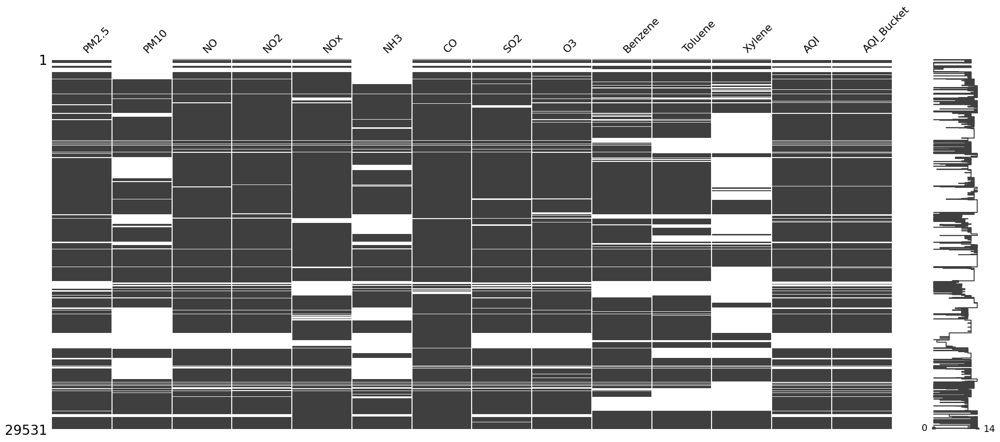

In [77]:
msno.matrix(df_copy)

In [78]:
df_copy.isnull().sum()


PM2.5          4598
PM10          11140
NO             3582
NO2            3585
NOx            4185
NH3           10328
CO             2059
SO2            3854
O3             4022
Benzene        5623
Toluene        8041
Xylene        18109
AQI            4681
AQI_Bucket     4681
dtype: int64

IMPUTATION USING 'MEDIAN' STRATEGY AGAINST EACH FEATURE

In [79]:
from sklearn.impute import SimpleImputer

SELECTING ONLY A SUBSET OF COLUMNS(POLLUTANTS) THAT HAVE MISSING VALUES AND STORING THEM IN A NEW DATAFRAME CONTAINING ONLY THOSE SELECTED COLUMNS.

In [80]:
cols = ['PM2.5','PM10','NO','NO2', 'NOx','NH3','CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI', 'AQI_Bucket']

df_c_imp = df_copy[cols]
df_c_imp

,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,NaN,NaN,0.92,18.22,17.15,NaN,0.92,27.64,133.36,0.00,0.02,0.00,NaN,NaN
1,NaN,NaN,0.97,15.69,16.46,NaN,0.97,24.55,34.06,3.68,5.50,3.77,NaN,NaN
2,NaN,NaN,17.40,19.30,29.70,NaN,17.40,29.07,30.70,6.80,16.40,2.25,NaN,NaN
3,NaN,NaN,1.70,18.48,17.97,NaN,1.70,18.59,36.08,4.43,10.14,1.00,NaN,NaN
4,NaN,NaN,22.10,21.42,37.76,NaN,22.10,39.33,39.31,7.01,18.89,2.78,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29526,15.02,50.94,7.68,25.06,19.54,12.47,0.47,8.55,23.30,2.24,12.07,0.73,41.0,0.0
29527,24.38,74.09,3.42,26.06,16.53,11.99,0.52,12.72,30.14,0.74,2.21,0.38,70.0,1.0
29528,22.91,65.73,3.45,29.53,18.33,10.71,0.48,8.42,30.96,0.01,0.01,0.00,68.0,1.0
29529,16.64,49.97,4.05,29.26,18.80,10.03,0.52,9.84,28.30,0.00,0.00,0.00,54.0,1.0


IMPUTATION OF MISSING VALUES IN 'df_copy' USING STRATEGY "MEDIAN" OF EACH FEATURE

In [81]:
from sklearn.impute import SimpleImputer

# Create a copy of the original DataFrame conatining only selected columns
df_imputed = df_c_imp.copy()

# Create a SimpleImputer instance with strategy='median'
imputer = SimpleImputer(strategy='median')

# Iterate over each column in the DataFrame and impute missing values with the median of that column
for column in df_imputed.columns:
    # Reshape the column to a 2D array as SimpleImputer expects 2D input
    column_data = df_imputed[column].values.reshape(-1, 1)

    # Impute missing values for the column
    imputed_column_data = imputer.fit_transform(column_data)

    # Replace the original column in the copied DataFrame with the imputed column
    df_imputed[column] = imputed_column_data

# Display the imputed DataFrame
(df_imputed)

,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,48.57,95.68,0.92,18.22,17.15,15.85,0.92,27.64,133.36,0.00,0.02,0.00,118.0,2.0
1,48.57,95.68,0.97,15.69,16.46,15.85,0.97,24.55,34.06,3.68,5.50,3.77,118.0,2.0
2,48.57,95.68,17.40,19.30,29.70,15.85,17.40,29.07,30.70,6.80,16.40,2.25,118.0,2.0
3,48.57,95.68,1.70,18.48,17.97,15.85,1.70,18.59,36.08,4.43,10.14,1.00,118.0,2.0
4,48.57,95.68,22.10,21.42,37.76,15.85,22.10,39.33,39.31,7.01,18.89,2.78,118.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29526,15.02,50.94,7.68,25.06,19.54,12.47,0.47,8.55,23.30,2.24,12.07,0.73,41.0,0.0
29527,24.38,74.09,3.42,26.06,16.53,11.99,0.52,12.72,30.14,0.74,2.21,0.38,70.0,1.0
29528,22.91,65.73,3.45,29.53,18.33,10.71,0.48,8.42,30.96,0.01,0.01,0.00,68.0,1.0
29529,16.64,49.97,4.05,29.26,18.80,10.03,0.52,9.84,28.30,0.00,0.00,0.00,54.0,1.0


CHECKING FOR SUCCESS OF IMPUTATION, THE OUTPUT BELOW SHOWS THAT ALL MISSING VALUES HAVE BEEN IMPUTED BY THE MEDIAN VALUE OF THAT PARTICULAR FEATURE.

In [82]:
df_imputed.isnull().sum()

PM2.5         0
PM10          0
NO            0
NO2           0
NOx           0
NH3           0
CO            0
SO2           0
O3            0
Benzene       0
Toluene       0
Xylene        0
AQI           0
AQI_Bucket    0
dtype: int64

SINCE MISSING VALUES CAN ONLY BE IMPUTED ON NUMERICAL VALUES, WE HAVE TO EXTRACT THE 'City' and 'Datetime' column from the dataframe 'df' to concatenate with the dataframe we obtained after impuation so that we can have the complete dataframe named 'df_imputed_combined'.

In [83]:
# Extract 'City' and 'Datetime' columns from the original DataFrame
city_date = df[['City', 'Date']]

# Create a DataFrame using the imputed data and columns from df_c_imp
df2 = pd.DataFrame(df_imputed, columns=cols)

# Concatenate 'City' and 'Datetime' columns with the imputed DataFrame
df_imputed_combined = pd.concat([city_date, df2], axis=1)

# Display the new DataFrame
df_imputed_combined


,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,Ahmedabad,2015-01-01,48.57,95.68,0.92,18.22,17.15,15.85,0.92,27.64,133.36,0.00,0.02,0.00,118.0,2.0
1,Ahmedabad,2015-01-02,48.57,95.68,0.97,15.69,16.46,15.85,0.97,24.55,34.06,3.68,5.50,3.77,118.0,2.0
2,Ahmedabad,2015-01-03,48.57,95.68,17.40,19.30,29.70,15.85,17.40,29.07,30.70,6.80,16.40,2.25,118.0,2.0
3,Ahmedabad,2015-01-04,48.57,95.68,1.70,18.48,17.97,15.85,1.70,18.59,36.08,4.43,10.14,1.00,118.0,2.0
4,Ahmedabad,2015-01-05,48.57,95.68,22.10,21.42,37.76,15.85,22.10,39.33,39.31,7.01,18.89,2.78,118.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
29526,Visakhapatnam,2020-06-27,15.02,50.94,7.68,25.06,19.54,12.47,0.47,8.55,23.30,2.24,12.07,0.73,41.0,0.0
29527,Visakhapatnam,2020-06-28,24.38,74.09,3.42,26.06,16.53,11.99,0.52,12.72,30.14,0.74,2.21,0.38,70.0,1.0
29528,Visakhapatnam,2020-06-29,22.91,65.73,3.45,29.53,18.33,10.71,0.48,8.42,30.96,0.01,0.01,0.00,68.0,1.0
29529,Visakhapatnam,2020-06-30,16.64,49.97,4.05,29.26,18.80,10.03,0.52,9.84,28.30,0.00,0.00,0.00,54.0,1.0


In [84]:
df_imputed_combined.head()

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,Ahmedabad,2015-01-01,48.57,95.68,0.92,18.22,17.15,15.85,0.92,27.64,133.36,0.00,0.02,0.00,118.0,2.0
1,Ahmedabad,2015-01-02,48.57,95.68,0.97,15.69,16.46,15.85,0.97,24.55,34.06,3.68,5.50,3.77,118.0,2.0
2,Ahmedabad,2015-01-03,48.57,95.68,17.40,19.30,29.70,15.85,17.40,29.07,30.70,6.80,16.40,2.25,118.0,2.0
3,Ahmedabad,2015-01-04,48.57,95.68,1.70,18.48,17.97,15.85,1.70,18.59,36.08,4.43,10.14,1.00,118.0,2.0
4,Ahmedabad,2015-01-05,48.57,95.68,22.10,21.42,37.76,15.85,22.10,39.33,39.31,7.01,18.89,2.78,118.0,2.0


In [85]:
df_imputed_combined.tail()

,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
29526,Visakhapatnam,2020-06-27,15.02,50.94,7.68,25.06,19.54,12.47,0.47,8.55,23.30,2.24,12.07,0.73,41.0,0.0
29527,Visakhapatnam,2020-06-28,24.38,74.09,3.42,26.06,16.53,11.99,0.52,12.72,30.14,0.74,2.21,0.38,70.0,1.0
29528,Visakhapatnam,2020-06-29,22.91,65.73,3.45,29.53,18.33,10.71,0.48,8.42,30.96,0.01,0.01,0.00,68.0,1.0
29529,Visakhapatnam,2020-06-30,16.64,49.97,4.05,29.26,18.80,10.03,0.52,9.84,28.30,0.00,0.00,0.00,54.0,1.0
29530,Visakhapatnam,2020-07-01,15.00,66.00,0.40,26.85,14.05,5.20,0.59,2.10,17.05,1.07,2.97,0.98,50.0,0.0


CHECKING FOR MISSING NUMBER VALUES IN CONCATENATED DATAFRAME ONCE AGAIN

In [86]:
df_imputed_combined.isnull().sum()

City          0
Date          0
PM2.5         0
PM10          0
NO            0
NO2           0
NOx           0
NH3           0
CO            0
SO2           0
O3            0
Benzene       0
Toluene       0
Xylene        0
AQI           0
AQI_Bucket    0
dtype: int64

CHECKING FOR THE DESCRIPTIVE STATISTICS IN 'df_imputed_combined'

In [87]:
df_imputed_combined.describe()

,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
count,29531,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000
mean,2018-05-14 05:40:15.807118080,64.510857,109.659366,16.642601,27.726576,31.063568,20.813789,2.153872,13.830897,33.994121,2.859874,7.140485,1.788420,158.781552,2.019065
min,2015-01-01 00:00:00,0.040000,0.010000,0.020000,0.010000,0.000000,0.010000,0.000000,0.010000,0.010000,0.000000,0.000000,0.000000,13.000000,0.000000
25%,2017-04-16 00:00:00,32.150000,79.315000,6.210000,12.980000,14.670000,12.040000,0.540000,6.090000,20.740000,0.240000,1.280000,0.980000,88.000000,1.000000
50%,2018-08-05 00:00:00,48.570000,95.680000,9.890000,21.690000,23.520000,15.850000,0.890000,9.160000,30.840000,1.070000,2.970000,0.980000,118.000000,2.000000
75%,2019-09-03 00:00:00,72.450000,111.880000,17.570000,34.665000,36.015000,21.755000,1.380000,13.810000,42.730000,2.420000,6.020000,0.980000,179.000000,2.000000
max,2020-07-01 00:00:00,949.990000,1000.000000,390.680000,362.210000,467.630000,352.890000,175.810000,193.860000,257.730000,455.030000,454.850000,170.370000,2049.000000,5.000000
std,NaN,59.807551,72.324020,21.506064,23.050531,29.477748,21.028862,6.724660,17.005647,20.202304,14.252822,17.224737,4.062039,130.272413,1.130620


CHECKING THE DISTRIBUTION OF THE DATA AFTER IMPUTATION BY KDE PLOTS

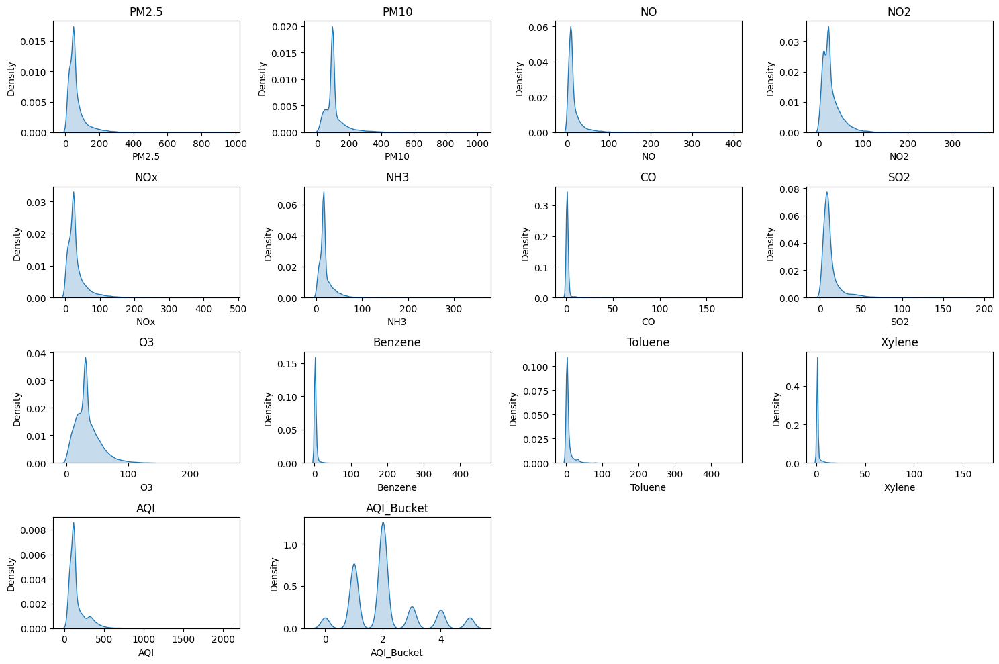

In [88]:
import seaborn as sns
import matplotlib.pyplot as plt

# Define the numeric columns for which KDE plots will be generated
numeric_columns = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI', 'AQI_Bucket']

# Set the figure size
plt.figure(figsize=(15, 10))

# Generate KDE plots for each numeric column
for i, column in enumerate(numeric_columns, 1):
    plt.subplot(4, 4, i)
    sns.kdeplot(df_imputed_combined[column], fill=True)
    plt.title(column)

# Adjust layout
plt.tight_layout()
plt.show()


CHECKING HISTOGRAM OF ALL POLLUTANT COLUMNS OF THE IMPUTED DATAFRAME 'df_imputed_combined'

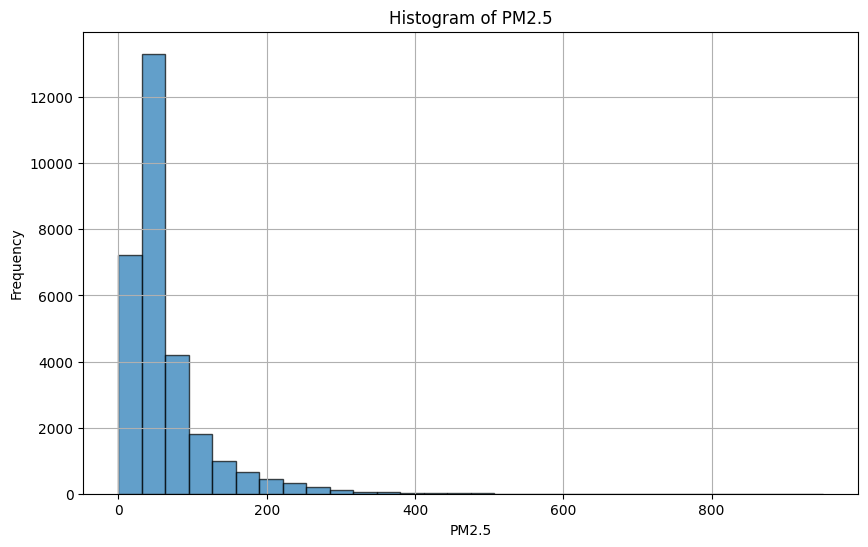

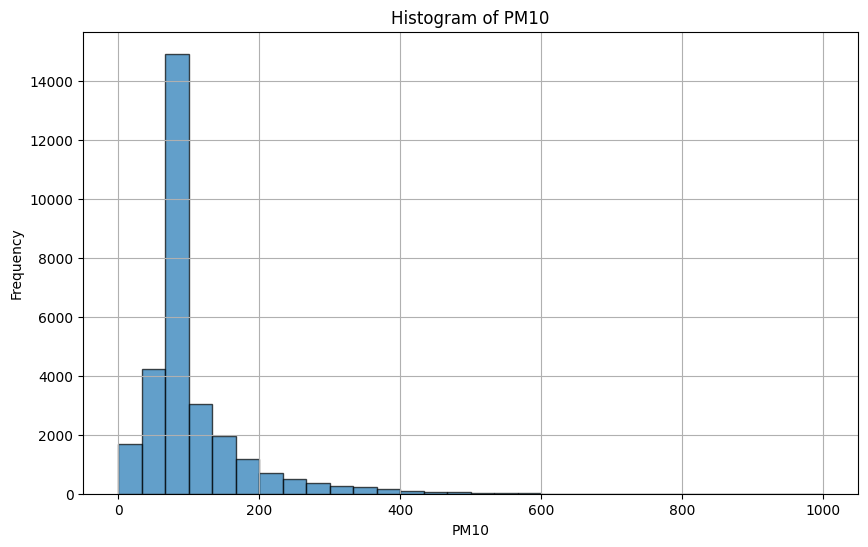

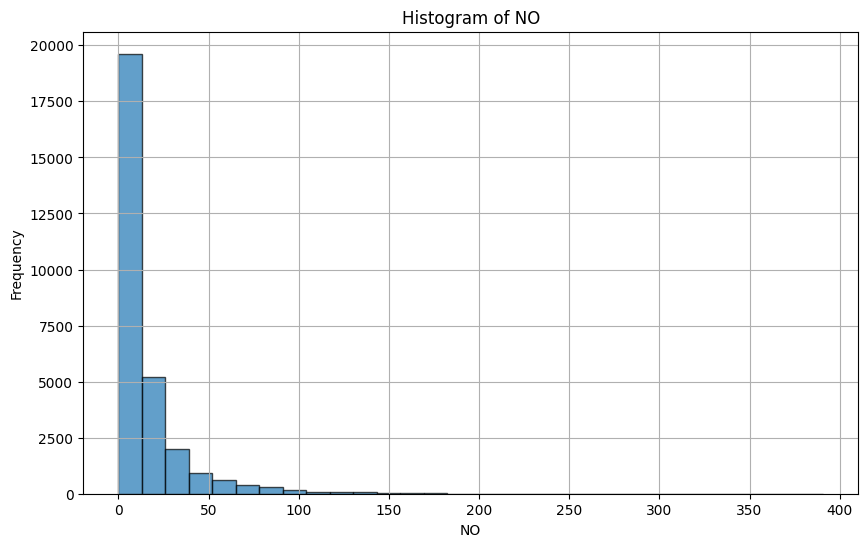

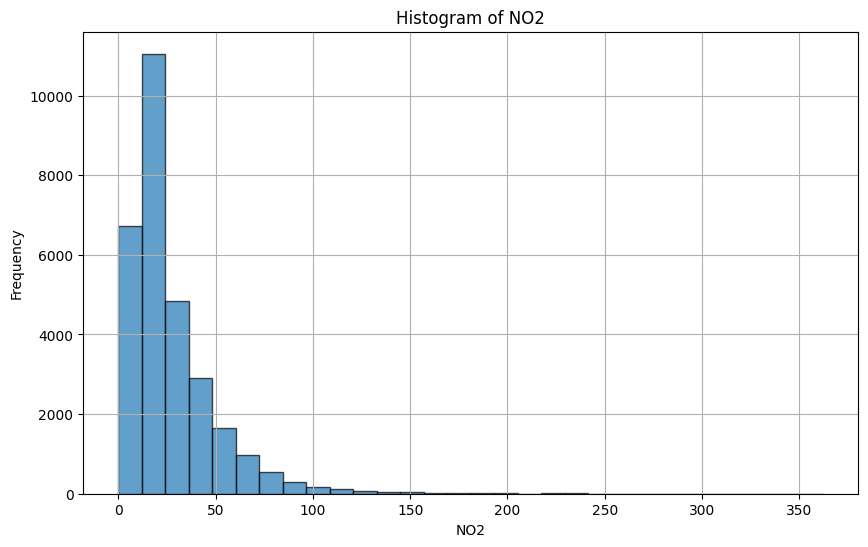

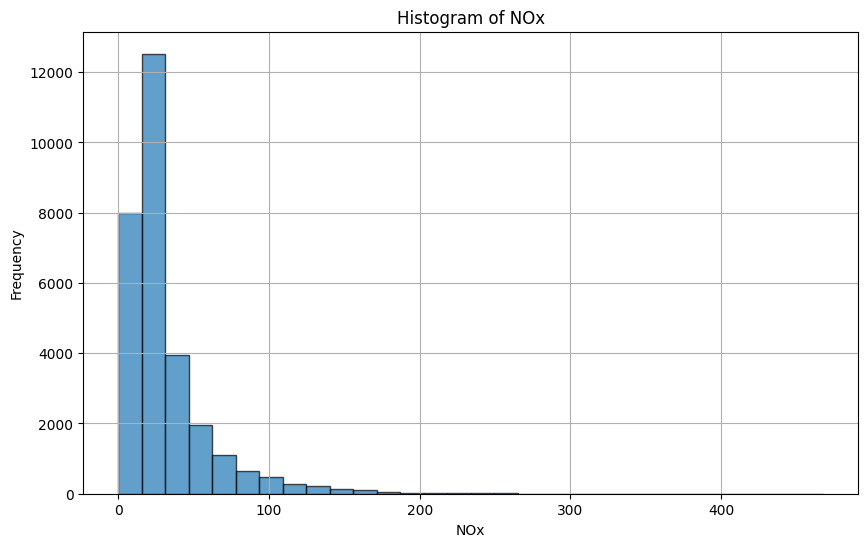

...

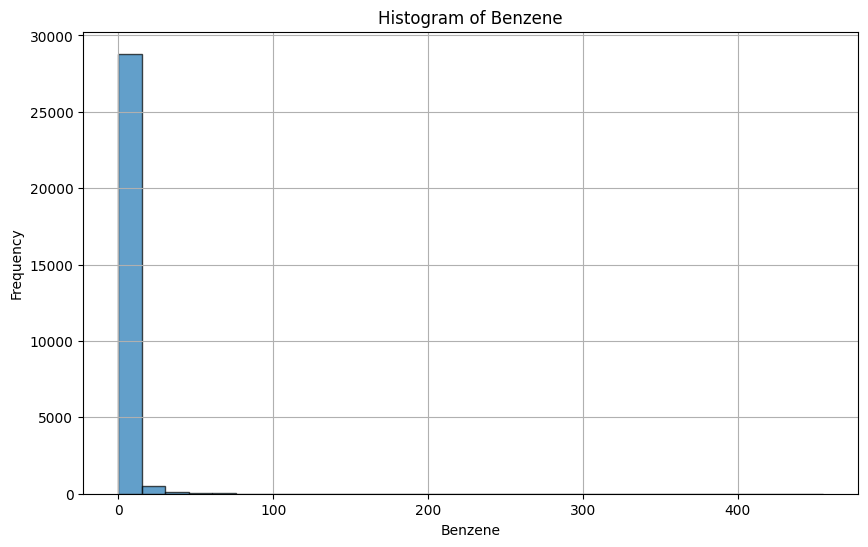

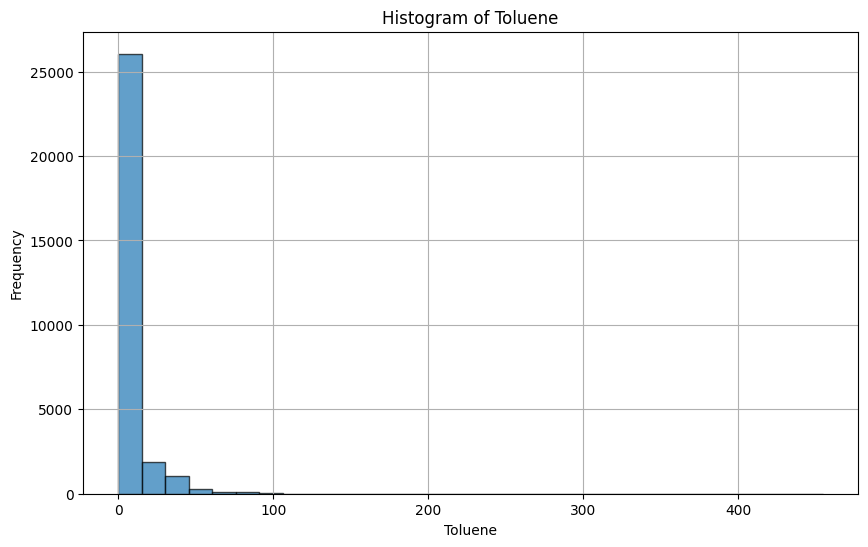

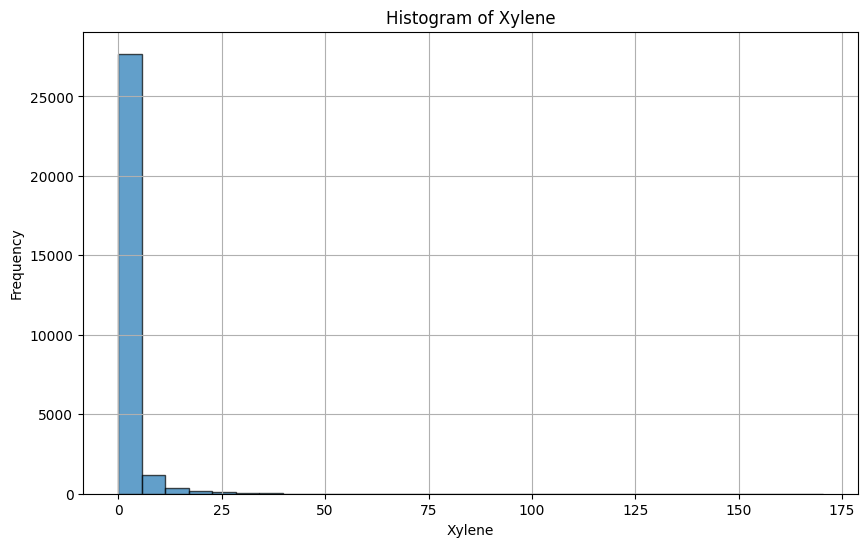

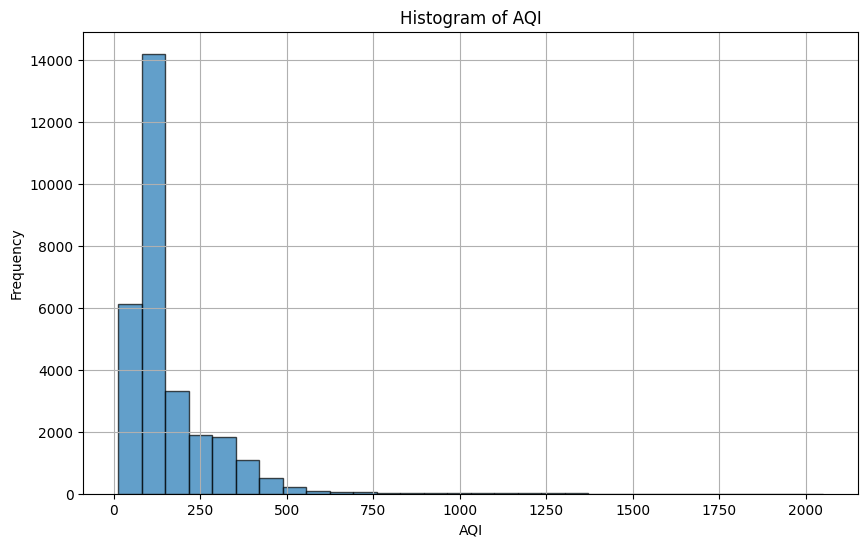

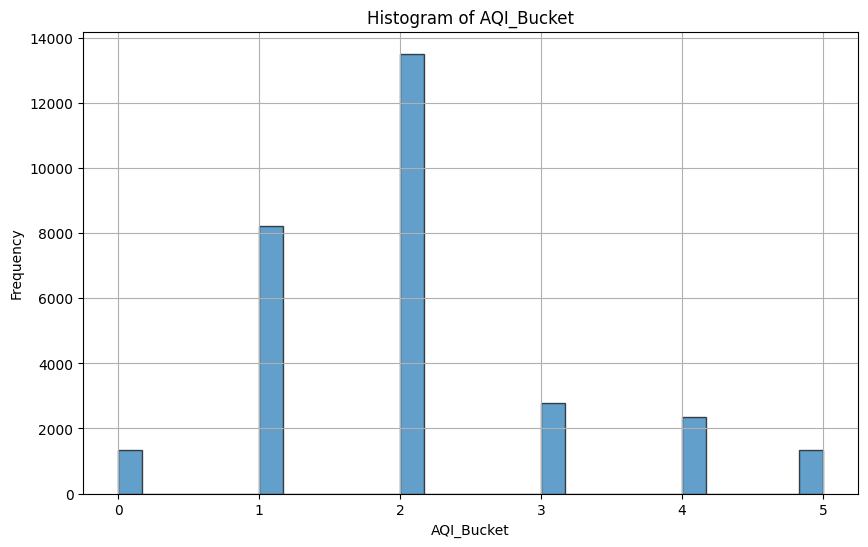

In [89]:
import pandas as pd
import matplotlib.pyplot as plt

# Assuming df_imputed_combined is already defined and contains the imputed data

# List of numeric columns (pollutant columns)
numeric_columns = df_imputed_combined.select_dtypes(include=[np.number]).columns

# Generate histograms for each numeric column
for column in numeric_columns:
    plt.figure(figsize=(10, 6))
    plt.hist(df_imputed_combined[column], bins=30, edgecolor='k', alpha=0.7)
    plt.title(f'Histogram of {column}')
    plt.xlabel(column)
    plt.ylabel('Frequency')
    plt.grid(True)
    plt.show()


SCATTER PLOT OF ALL THE POLLUTANTS IN 'df_imputed_combined'

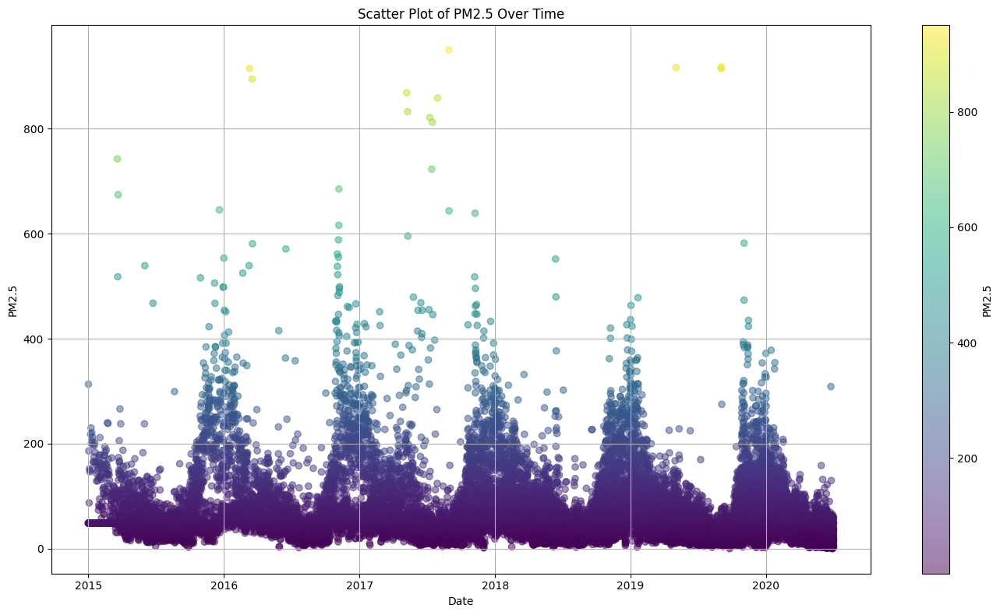

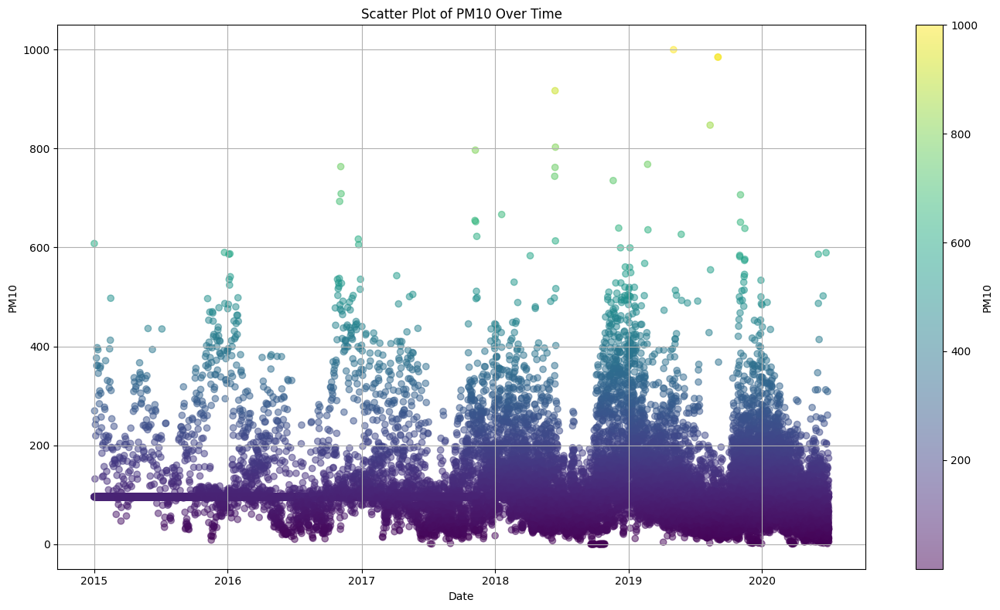

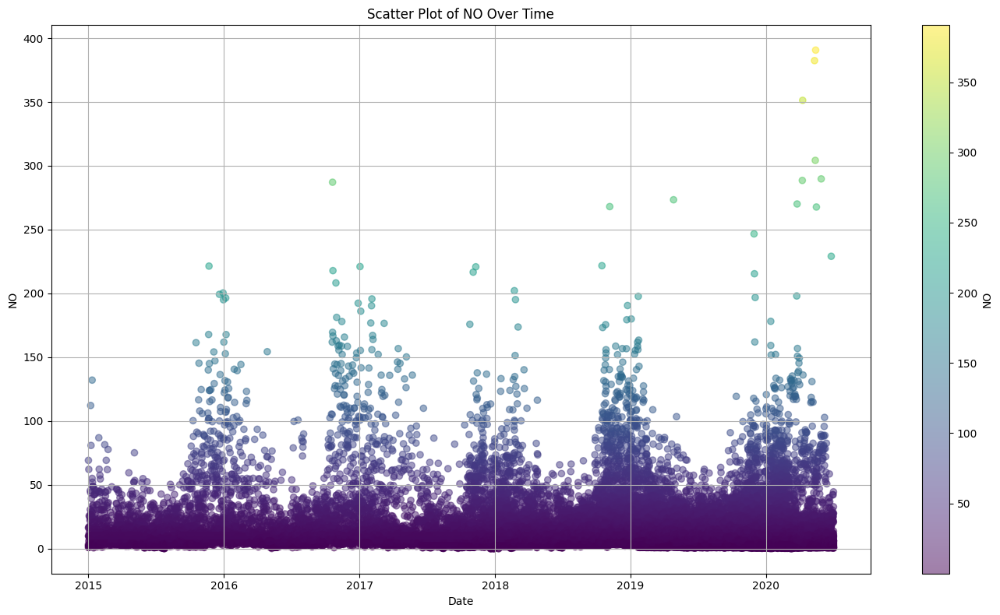

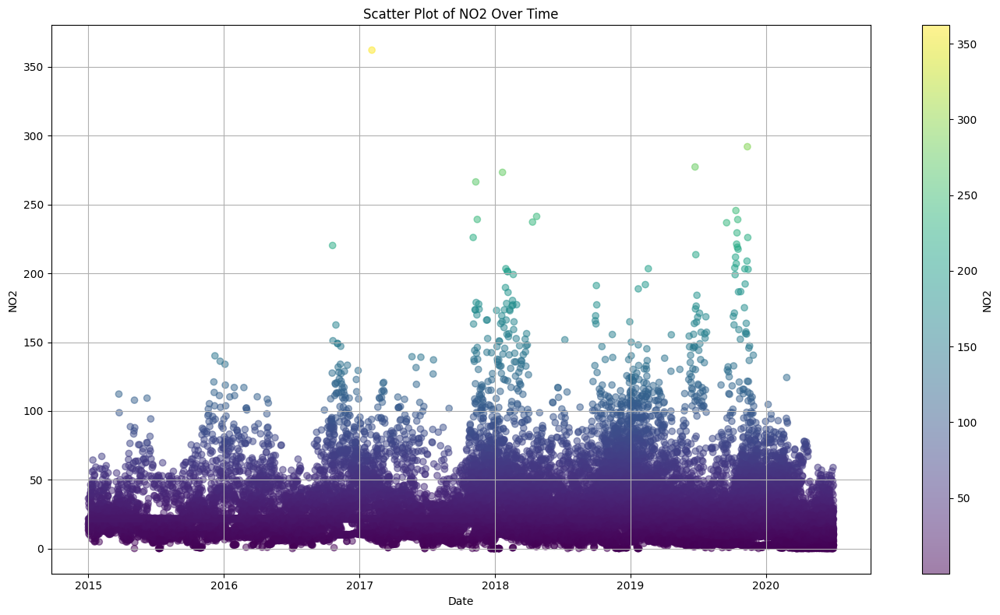

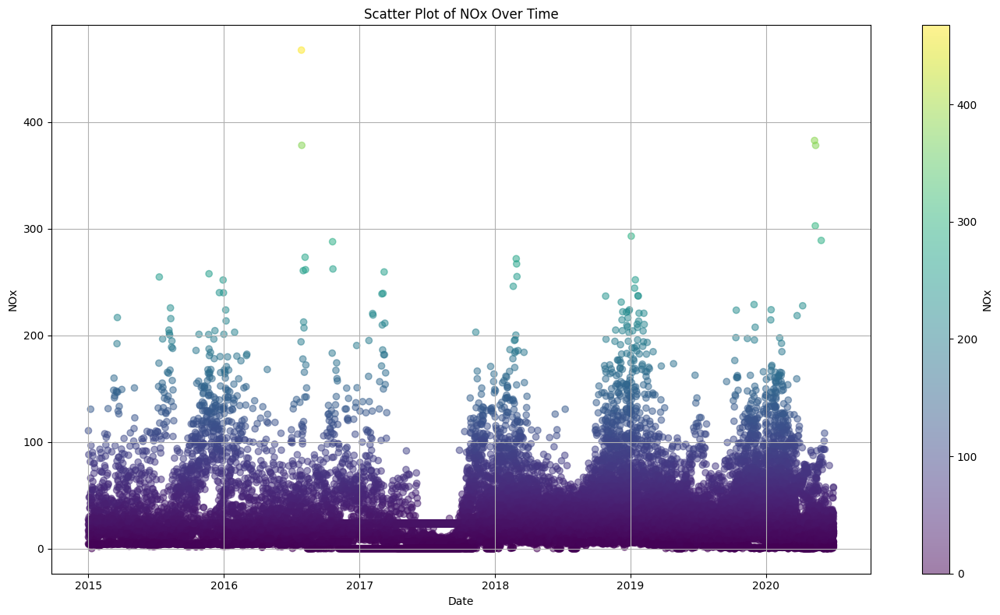

...

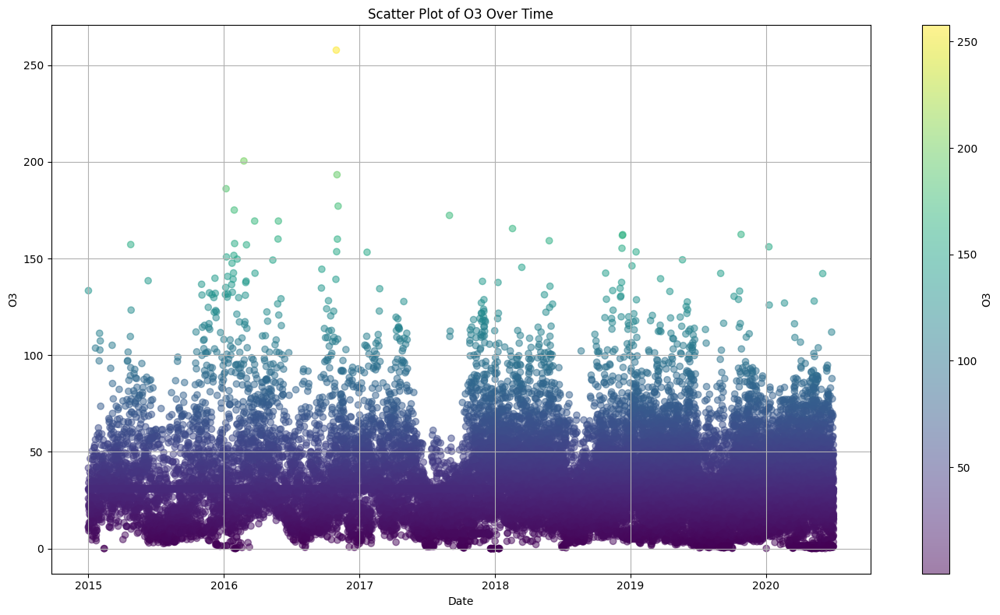

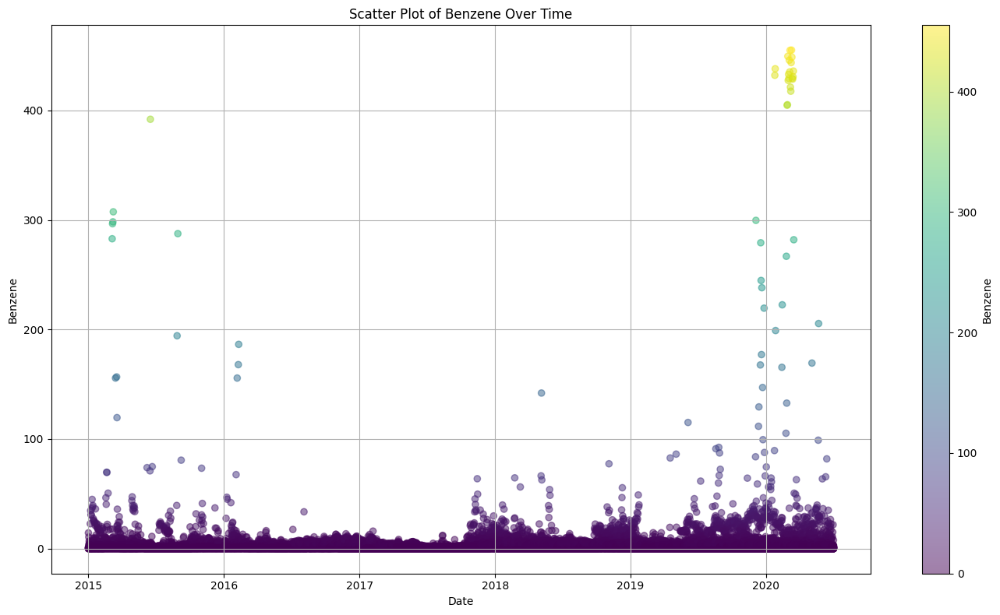

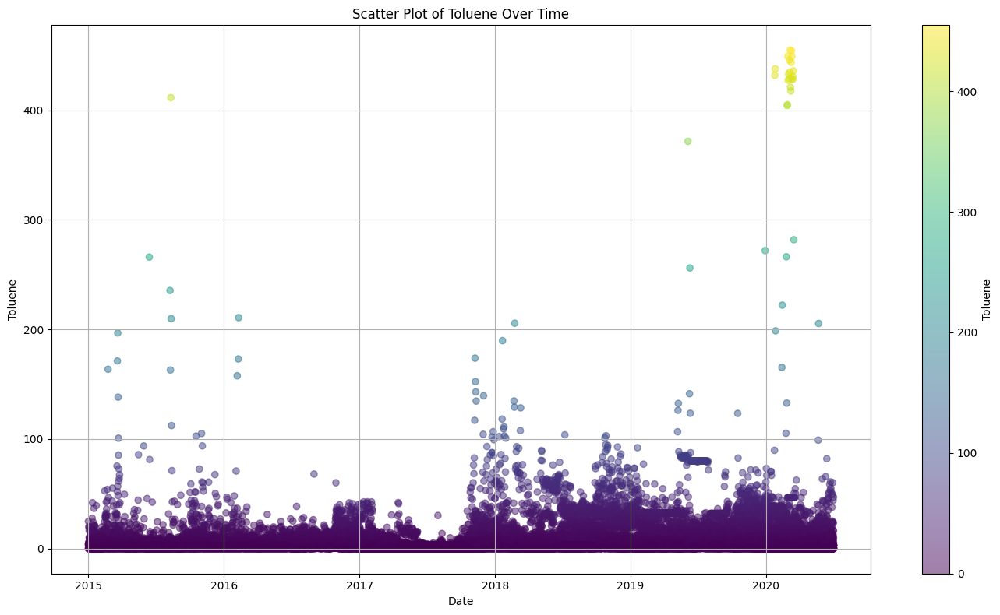

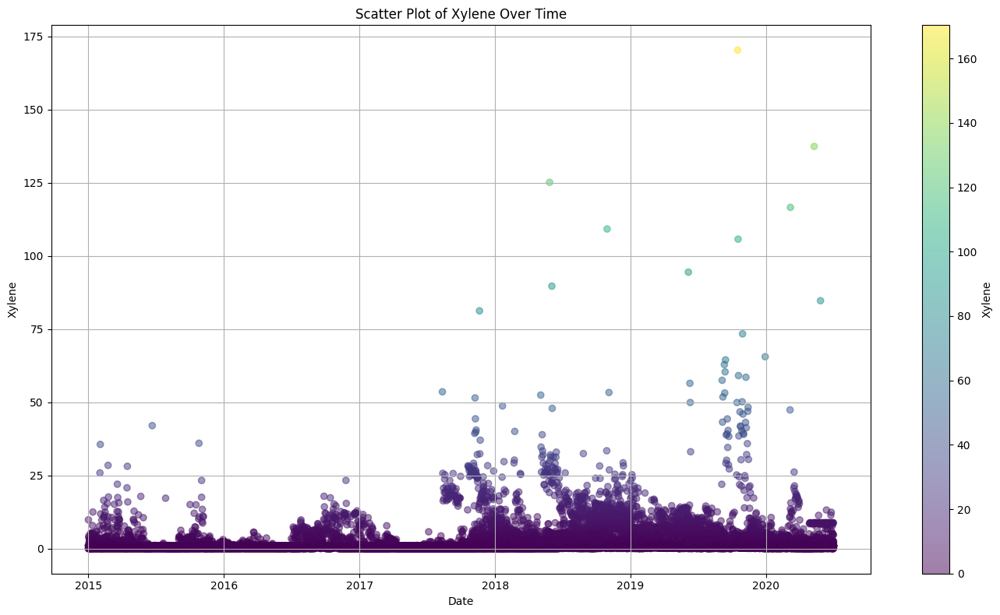

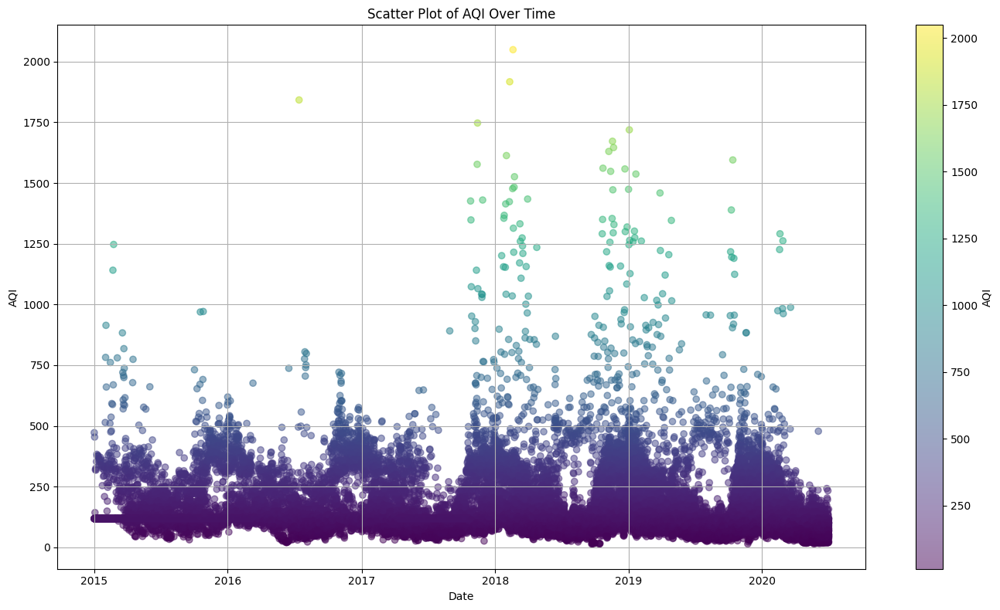

In [91]:
import pandas as pd
import matplotlib.pyplot as plt

# List of pollutant columns
pollutant_columns = [
    'PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3',
    'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI'
]

# Generate scatter plots for each pollutant column
for column in pollutant_columns:
    plt.figure(figsize=(14, 8))
    plt.scatter(df_imputed_combined['Date'], df_imputed_combined[column], alpha=0.5, label=column, c=df_imputed_combined[column], cmap='viridis')
    plt.colorbar(label=column)
    plt.title(f'Scatter Plot of {column} Over Time')
    plt.xlabel('Date')
    plt.ylabel(column)
    plt.grid(True)
    plt.tight_layout()
    plt.show()


In [96]:
# import pandas as pd
# import matplotlib.pyplot as plt

# # Make a copy of the original dataframe
# #df_copy = df_imputed_combined.copy()

# # Check for extremely high PM10 values
# high_AQI = df_imputed_combined[df_imputed_combined['AQI'] > 500]
# print(f"Number of instances with AQI >500: {len(high_AQI)}")
# high_PM25 = df_imputed_combined[df_imputed_combined['PM2.5'] > 400]
# print(f"Number of instances with PM2.5 >400: {len(high_PM25)}")
# # Display the instances with very high PM10 values
# print(high_AQI[['City', 'Date', 'AQI']])
# print(high_PM25[['City', 'Date', 'PM2.5']])

FROM THE KDE PLOTS AS WELL AS THE HISTOGRAMS PLOTTED ABOVE, WE CAN SEE THAT ALMOST ALL OF THE POLLUTANT COLUMNS HAVE A RIGHT SKEWED DISTRIBUTION. WE WILL FIRST CALCULATE THE SKEWNESS VALUES AND THEN APPLY LOG TRANSFORMATION FIRST ON ALL OF THE RIGHT SKEWED FATURES SO THAT WE CAN BRING THEM APPROXIMATELY CLOSER TO THE SHAPE OF A NORMAL DISTRIBUTION AND THAT WILL ALSO HELP TO MITIGATE THE IMPACT OF OUTLIERS.
The NEW DATAFRAME IS 'df_logtransform'.

In [98]:
import seaborn as sns

# Select pollutant columns
pollutant_columns = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI']

for col in pollutant_columns:
    # Calculate skewness
    skewness = df_imputed_combined[col].skew()
    print(f"{col}: Skewness = {skewness}")



PM2.5: Skewness = 3.7383701781339544
PM10: Skewness = 2.855443778387974
NO: Skewness = 4.1827985719032625
NO2: Skewness = 2.6974079553129195
NOx: Skewness = 2.85217214814067
NH3: Skewness = 5.204658865450054
CO: Skewness = 9.210144191675717
SO2: Skewness = 4.424851683215641
O3: Skewness = 1.4959537016437252
Benzene: Skewness = 23.6333802895764
Toluene: Skewness = 13.490401748746336
Xylene: Skewness = 12.406313834564507
AQI: Skewness = 3.76975148929373


VISUALIZING SKEWNESS IN DESCENDING ORDER

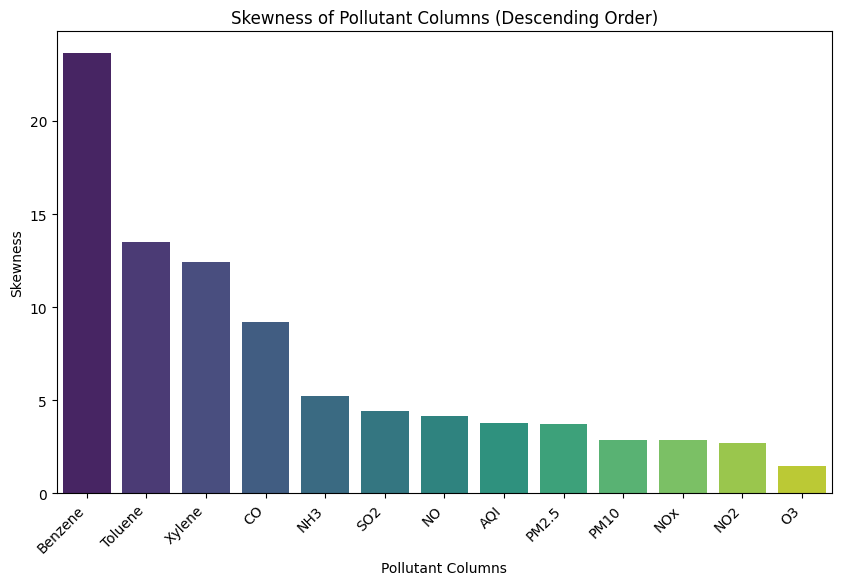

In [99]:
import seaborn as sns
import matplotlib.pyplot as plt

# Select pollutant columns
pollutant_columns = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI']

# Calculate skewness of each pollutant column
skewness_values = {col: df_imputed_combined[col].skew() for col in pollutant_columns}

# Sort the skewness values in descending order
sorted_skewness = sorted(skewness_values.items(), key=lambda x: x[1], reverse=True)

# Extract sorted columns and skewness values
sorted_columns = [item[0] for item in sorted_skewness]
sorted_skewness_values = [item[1] for item in sorted_skewness]

# Create a bar plot for skewness of pollutant columns
plt.figure(figsize=(10, 6))
sns.barplot(x=sorted_columns, y=sorted_skewness_values, hue=sorted_columns, dodge=False, palette='viridis')

# Add labels and title
plt.xlabel('Pollutant Columns')
plt.ylabel('Skewness')
plt.title('Skewness of Pollutant Columns (Descending Order)')

# Rotate x-axis labels for better readability
plt.xticks(rotation=45, ha='right')

# Show plot
plt.show()



APPLYING LOG TRANSFORM AND USING log1p BECAUSE ln(1) = 0

THE log1p FUNCTION IS DEFINED AS:
log1p(X) = ln(1 + X)
So, if my values of X are so small that it approximately scales to 0, ln(1+x) approximates to x so it can handle zero values.

THIS TRANSFORMATION IS PARTICULARLY ADVANTAGEOUS FOR:

SMALL X VALUES: LN(1 + X) ≈ X WHEN X IS CLOSE TO ZERO.
LARGE X VALUES: IT PROVIDES THE NATURAL LOGARITHM TRANSFORMATION FOR LARGER VALUES, REDUCING SKEWNESS AND COMPRESSING THE RANGE OF THE DATA.

In [100]:
# Make a copy of the DataFrame
df_logtransform = df_imputed_combined.copy()

# List of skewed features
#skewed_features = ['Benzene', 'CO', 'Xylene', 'Toluene']

# Apply logarithmic transformation to skewed features
for pollutant in pollutant_columns:
    df_logtransform [pollutant] = np.log1p(df_logtransform[pollutant])

# Display the transformed DataFrame
df_logtransform.head()




,City,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
0,Ahmedabad,2015-01-01,3.903386,4.571407,0.652325,2.955951,2.898671,2.824351,0.652325,3.354804,4.900523,0.000000,0.019803,0.000000,4.779123,2.0
1,Ahmedabad,2015-01-02,3.903386,4.571407,0.678034,2.814810,2.859913,2.824351,0.678034,3.240637,3.557061,1.543298,1.871802,1.562346,4.779123,2.0
2,Ahmedabad,2015-01-03,3.903386,4.571407,2.912351,3.010621,3.424263,2.824351,2.912351,3.403528,3.456317,2.054124,2.856470,1.178655,4.779123,2.0
3,Ahmedabad,2015-01-04,3.903386,4.571407,0.993252,2.969388,2.942859,2.824351,0.993252,2.975019,3.613078,1.691939,2.410542,0.693147,4.779123,2.0
4,Ahmedabad,2015-01-05,3.903386,4.571407,3.139833,3.109953,3.657389,2.824351,3.139833,3.697096,3.696600,2.080691,2.990217,1.329724,4.779123,2.0


CHECKING KDE PLOTS AFTER APPLYING LOG TRANSFORMATION

WE CAN SEE THAT THE POLLUATNTS ARE NOW LESS SKEWED AND APPROXIMATELY GETS AS CLOSE AS POSSIBLE TO THE SHAPE OF A NORMAL DISTRIBUTION.

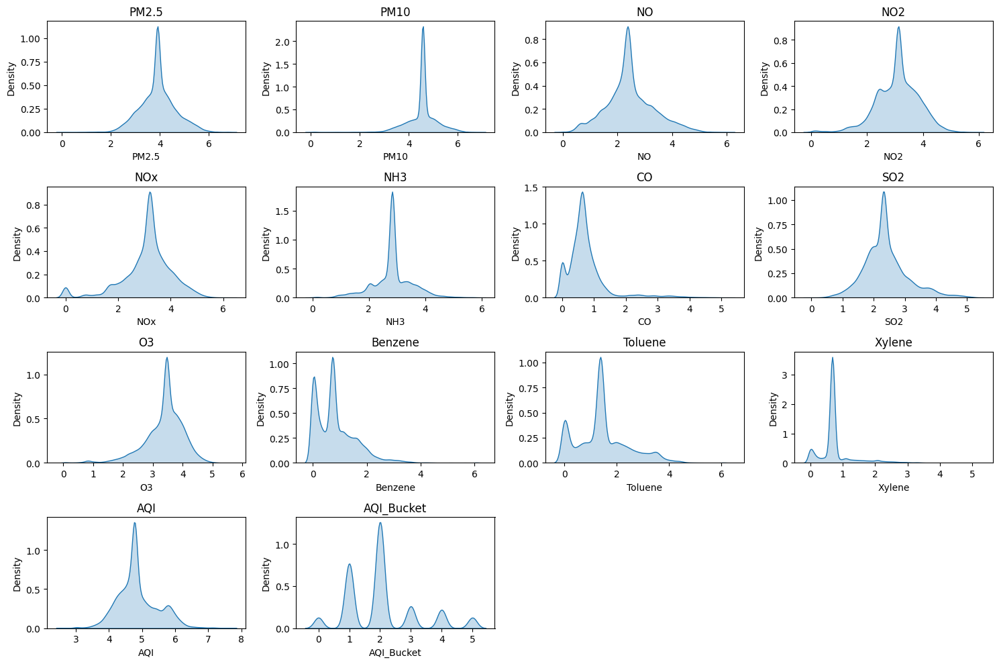

In [103]:
import seaborn as sns
import matplotlib.pyplot as plt


# Filter numeric columns
numeric_columns = df_logtransform.select_dtypes(include=['float64', 'int64']).columns

# Set the figure size
plt.figure(figsize=(15, 10))

# Generate KDE plots for each numeric column
for i, column in enumerate(numeric_columns, 1):
    plt.subplot(4, 4, i)
    sns.kdeplot(df_logtransform[column], fill=True)
    plt.title(column)

# Adjust layout
plt.tight_layout()
plt.show()


CHECKING SCATTER PLOTS OF ALL THE POLLUTANTS

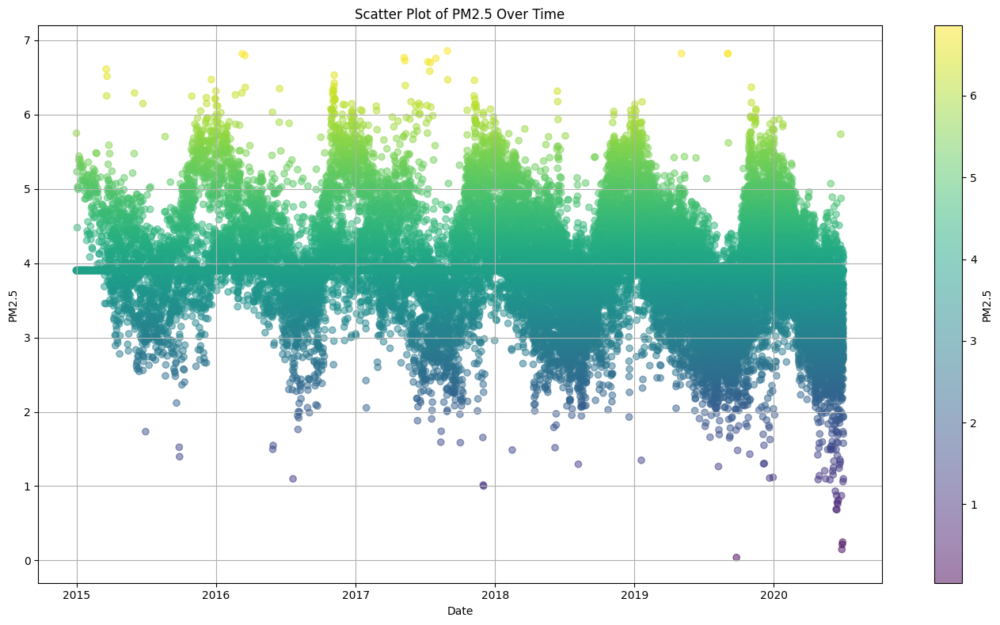

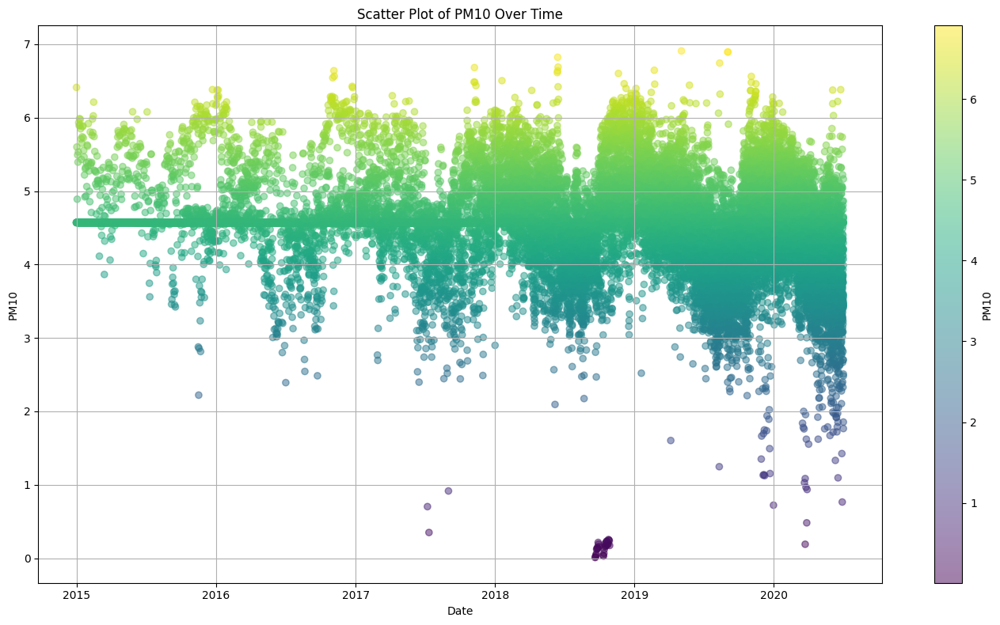

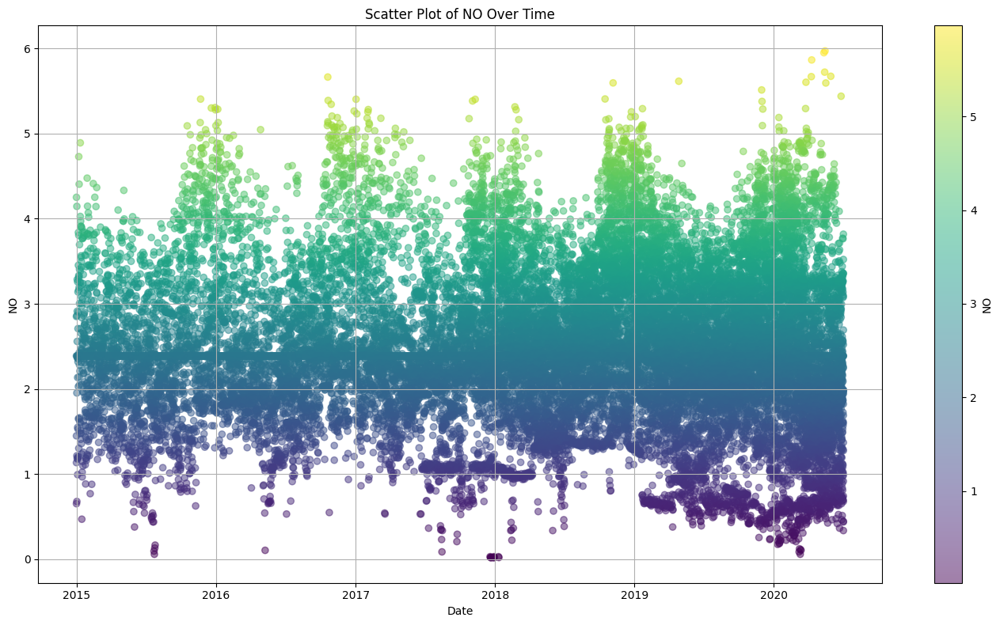

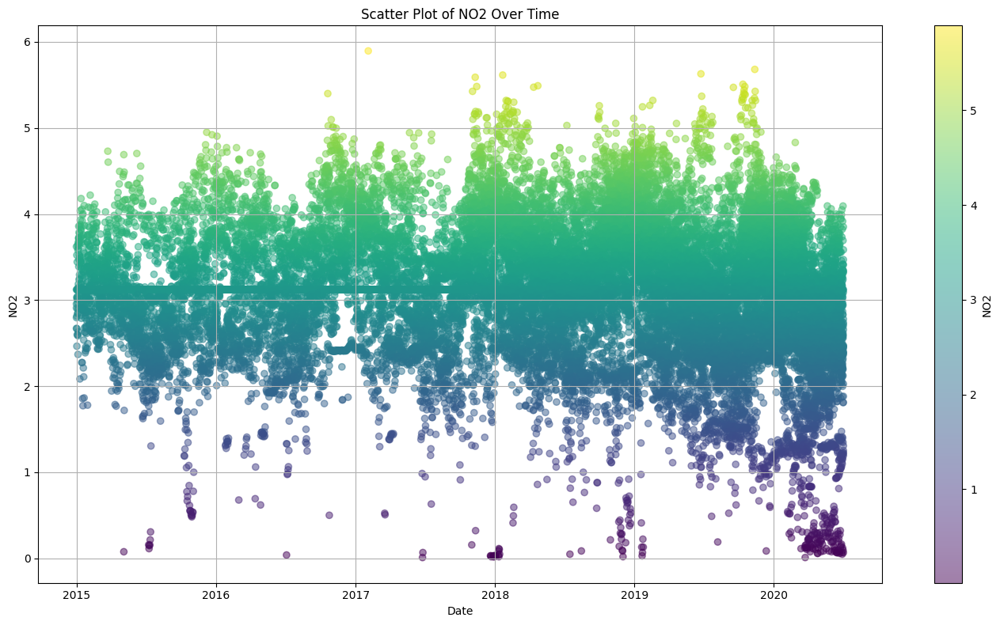

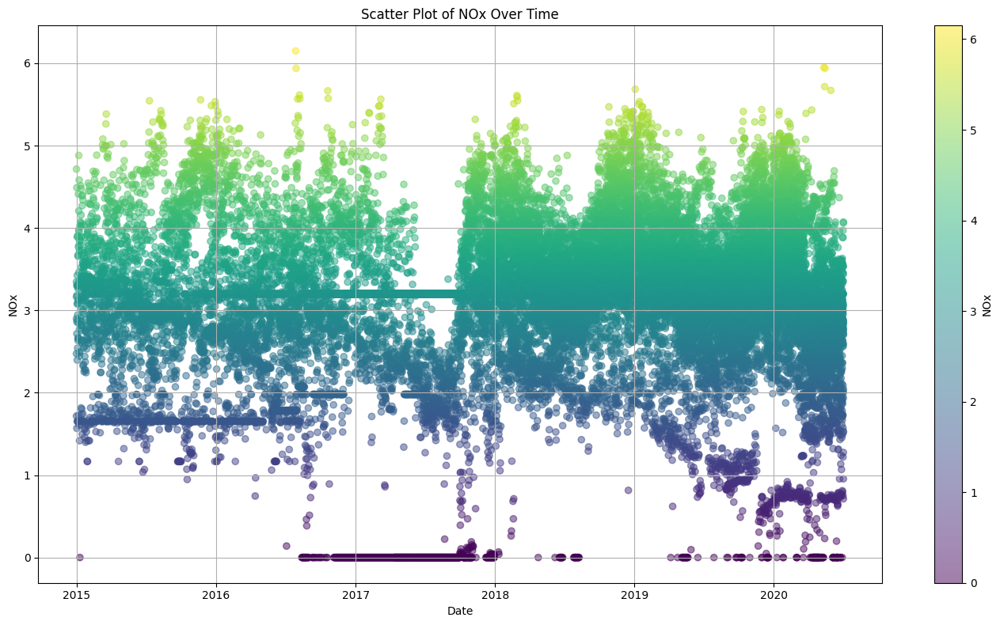

...

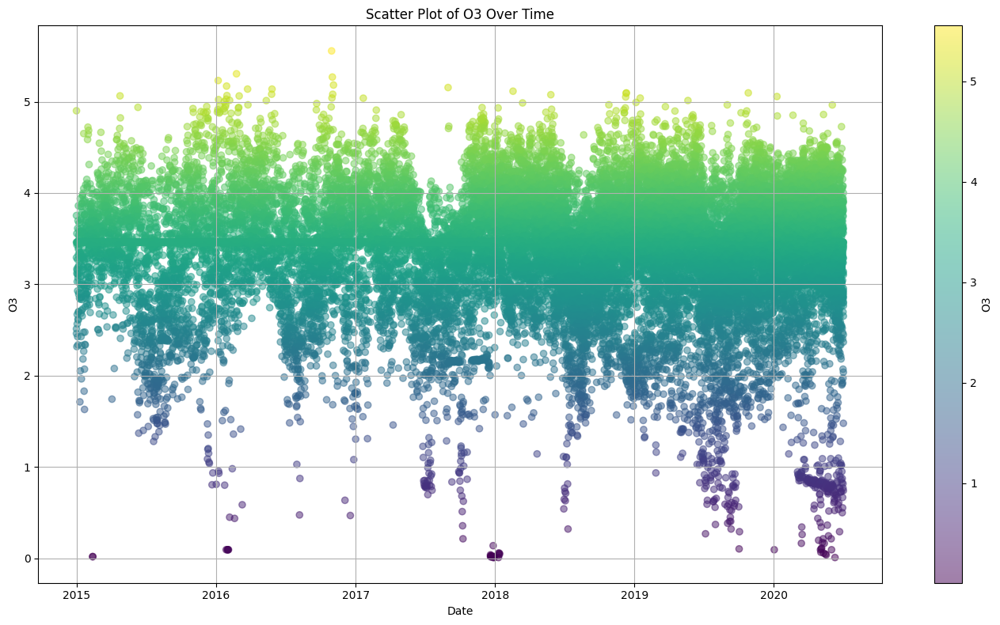

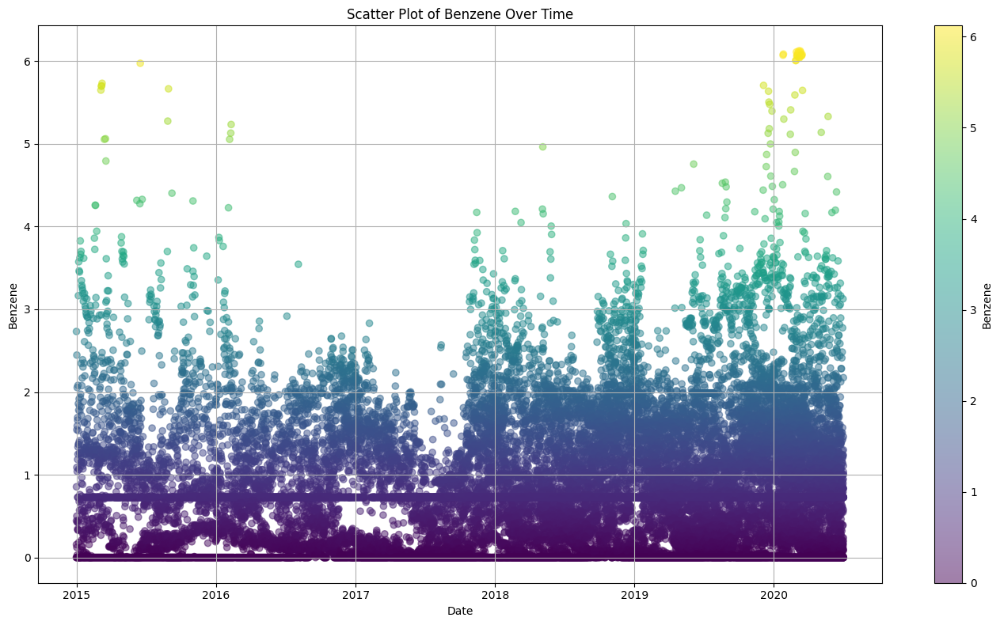

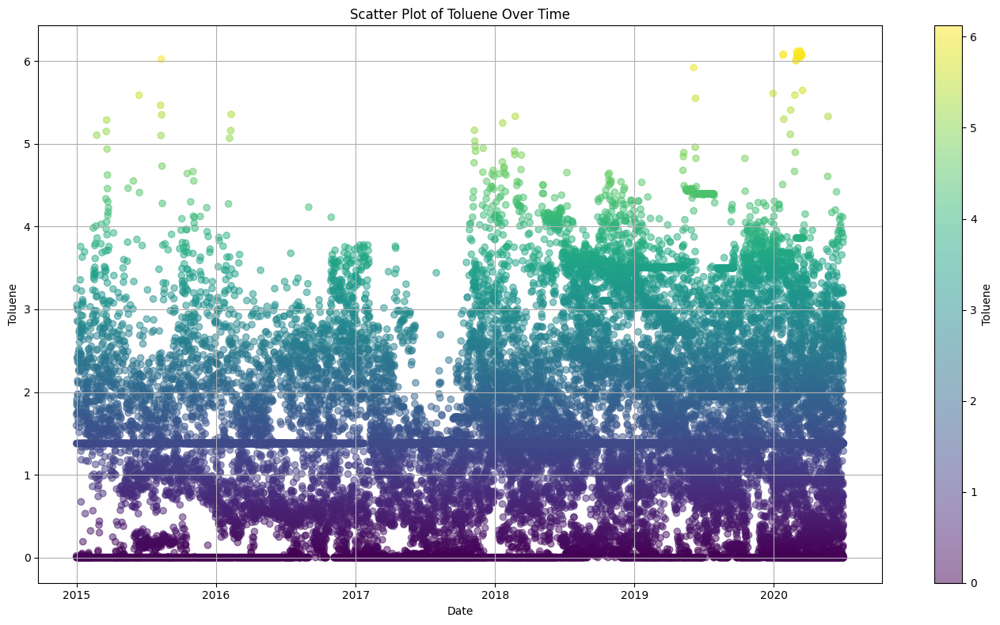

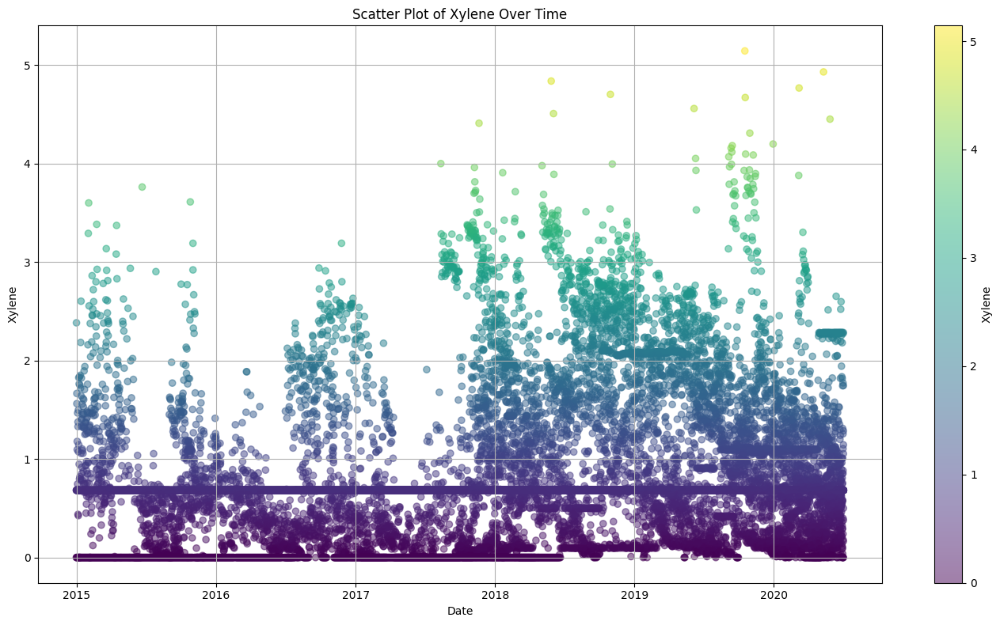

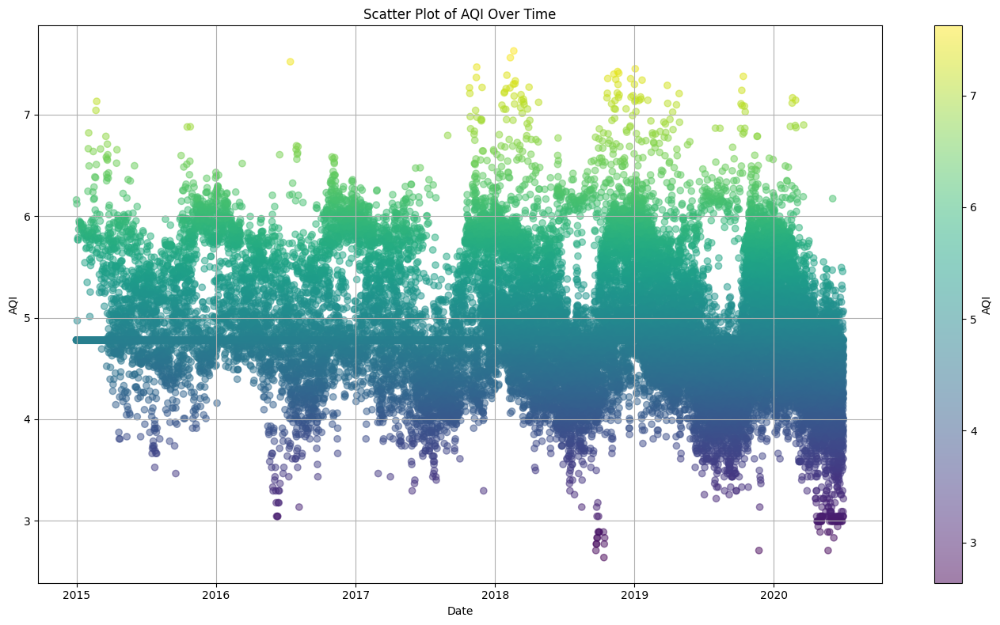

In [105]:
import pandas as pd
import matplotlib.pyplot as plt

# List of pollutant columns
pollutant_columns = [
    'PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3',
    'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI'
]
# Generate scatter plots for each pollutant column
for column in pollutant_columns:
    plt.figure(figsize=(14, 8))
    plt.scatter(df_logtransform['Date'], df_logtransform[column], alpha=0.5, label=column, c=df_logtransform[column], cmap='viridis')
    plt.colorbar(label=column)
    plt.title(f'Scatter Plot of {column} Over Time')
    plt.xlabel('Date')
    plt.ylabel(column)
    plt.grid(True)
    plt.tight_layout()
    plt.show()


NORMALIZATION OF THE DATA USING STANDARD SCALAR ON 'df_logtransform'



In [ ]:
# from sklearn.preprocessing import StandardScaler
# import pandas as pd

# # Create a copy of the DataFrame
# df_standard_scalar = df_logtransform.copy()

# # List of numeric columns for standardization
# numeric_columns = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI', 'AQI_Bucket']

# # Initialize StandardScaler
# scaler = StandardScaler()

# # Apply standardization to numeric columns
# df_standard_scalar[numeric_columns] = scaler.fit_transform(df_standard_scalar[numeric_columns])


In [ ]:
#df_standard_scalar.describe()

KDE PLOT FOR LOG TRANSFORMED AND STANDARDIZED DATA

AS SEEN BELOW, SCALING HAS NOT HAD ANY IMPACT ON THE SHAPE OF THE KDE PLOT DERIVED AFTER USING LOG TRANSFORMATION.

In [ ]:
# import seaborn as sns
# import matplotlib.pyplot as plt

# # Filter numeric columns
# numeric_columns = df_standard_scalar.select_dtypes(include=['float64', 'int64']).columns

# # Set the figure size
# plt.figure(figsize=(15, 10))

# # Generate KDE plots for each numeric column
# for i, column in enumerate(numeric_columns, 1):
#     plt.subplot(4, 4, i)
#     sns.kdeplot(df_standard_scalar[column], fill=True)
#     plt.title(column)

# # Adjust layout
# plt.tight_layout()
# plt.show()


MIN MAX SCALAR

In [106]:
from sklearn.preprocessing import MinMaxScaler
import pandas as pd


# Create a copy of the DataFrame
df_minmax_scaled = df_logtransform.copy()

# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# Select numeric columns for scaling (including 'AQI_Bucket')
numeric_columns = df_minmax_scaled.select_dtypes(include='number').columns.tolist()

# Apply Min-Max scaling to numeric columns
df_minmax_scaled[numeric_columns] = scaler.fit_transform(df_minmax_scaled[numeric_columns])

# Show the scaled DataFrame
print("Min-Max Scaled DataFrame:")
print(df_minmax_scaled)


Min-Max Scaled DataFrame:
                City       Date     PM2.5      PM10        NO       NO2  \
0          Ahmedabad 2015-01-01  0.566736  0.661195  0.106295  0.500592   
1          Ahmedabad 2015-01-02  0.566736  0.661195  0.110615  0.476609   
2          Ahmedabad 2015-01-03  0.566736  0.661195  0.486090  0.509882   
3          Ahmedabad 2015-01-04  0.566736  0.661195  0.163587  0.502876   
4          Ahmedabad 2015-01-05  0.566736  0.661195  0.524318  0.526761   
...              ...        ...       ...       ...       ...       ...   
29526  Visakhapatnam 2020-06-27  0.401071  0.571134  0.359830  0.552325   
29527  Visakhapatnam 2020-06-28  0.468555  0.624563  0.246417  0.558724   
29528  Visakhapatnam 2020-06-29  0.459804  0.607454  0.247553  0.579225   
29529  Visakhapatnam 2020-06-30  0.415200  0.568401  0.268809  0.577716   
29530  Visakhapatnam 2020-07-01  0.400888  0.608039  0.053216  0.563613   

            NOx       NH3        CO       SO2        O3   Benzene   Tolue

In [107]:
df_minmax_scaled.describe()

,Date,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
count,29531,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000,29531.000000
mean,2018-05-14 05:40:15.807118080,0.568020,0.656787,0.410387,0.524116,0.505430,0.480798,0.144546,0.451868,0.606790,0.138300,0.239509,0.150461,0.446264,0.403813
min,2015-01-01 00:00:00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,2017-04-16 00:00:00,0.507726,0.634314,0.328648,0.446502,0.447452,0.436603,0.083435,0.370318,0.553425,0.035134,0.134622,0.132799,0.370914,0.200000
50%,2018-08-05 00:00:00,0.566736,0.661195,0.397947,0.528795,0.520258,0.480352,0.123008,0.438685,0.622228,0.118831,0.225209,0.132799,0.429169,0.400000
75%,2019-09-03 00:00:00,0.624407,0.683651,0.487636,0.605642,0.587225,0.531629,0.167553,0.510297,0.679444,0.200838,0.318313,0.132799,0.512159,0.400000
max,2020-07-01 00:00:00,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
std,NaN,0.105440,0.086028,0.144010,0.127685,0.151989,0.119250,0.123521,0.134815,0.118938,0.124263,0.164187,0.108173,0.122956,0.226124


VISUALIZING KDE PLOTS AFTER MIN MAX SCALING, THE SHAPE OF THE DISTRIBUTION OBTAINED AFTER USING LOG TRANSFORMATION REMAINS UNCHANGED.

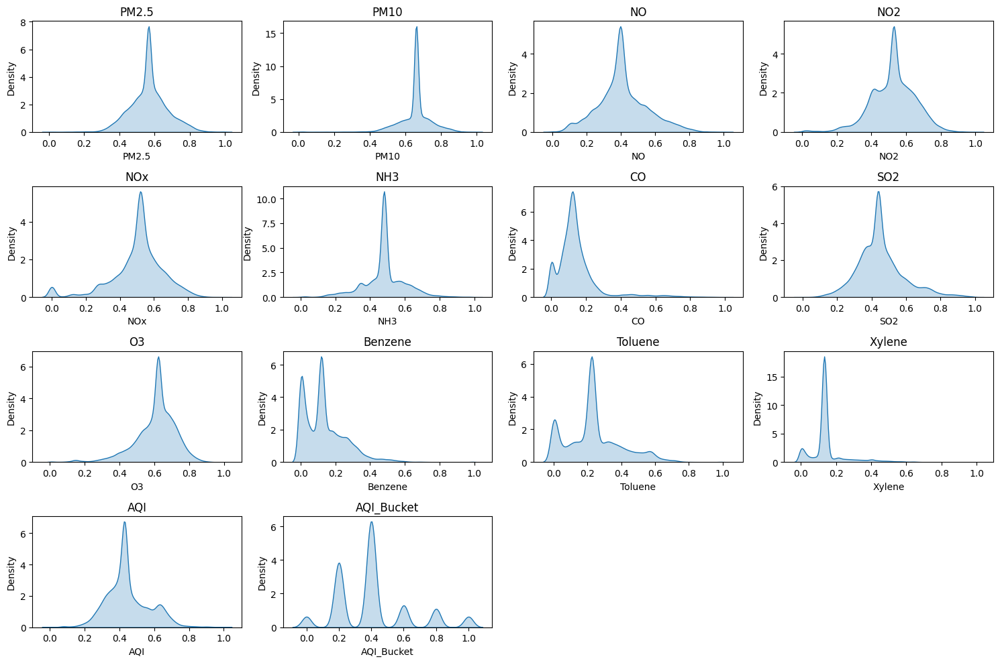

In [108]:
import seaborn as sns
import matplotlib.pyplot as plt

# Filter numeric columns
numeric_columns = df_minmax_scaled.select_dtypes(include=['float64', 'int64']).columns

# Set the figure size
plt.figure(figsize=(15, 10))

# Generate KDE plots for each numeric column
for i, column in enumerate(numeric_columns, 1):
    plt.subplot(4, 4, i)
    sns.kdeplot(df_minmax_scaled[column], fill=True)
    plt.title(column)

# Adjust layout
plt.tight_layout()
plt.show()

BOX PLOT AFTER LOG TRANSFORMATION AND MIN MAX SCALING

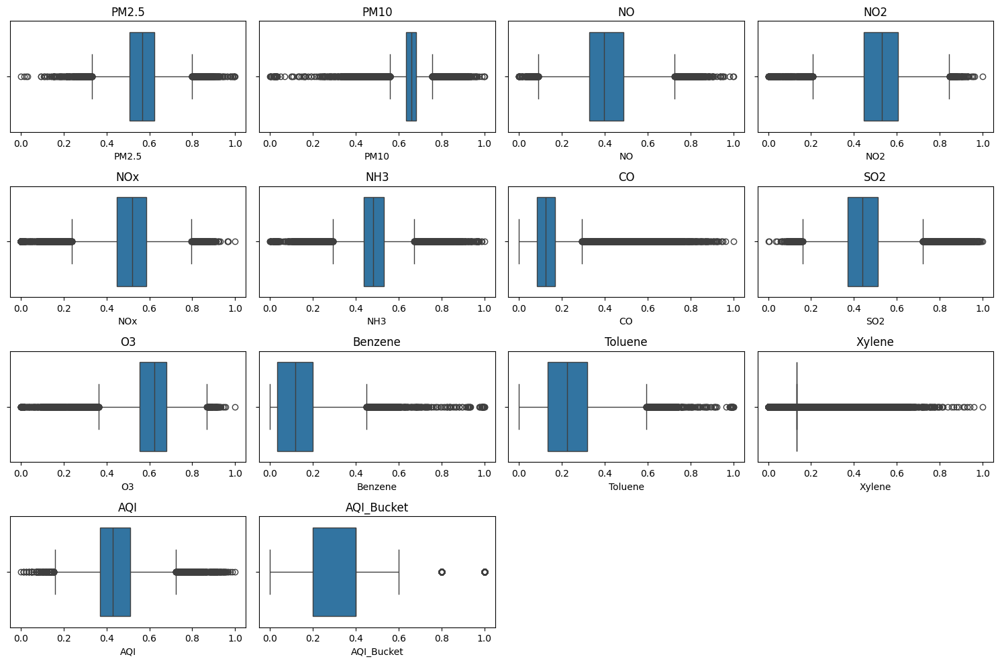

In [109]:
import seaborn as sns
import matplotlib.pyplot as plt

# Set the figure size
plt.figure(figsize=(15, 10))

pollutant_columns = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI', 'AQI_Bucket']
# Generate box plots for each pollutant column
for i, column in enumerate(pollutant_columns, 1):
    plt.subplot(4, 4, i)
    sns.boxplot(x=df_minmax_scaled[column])
    plt.title(column)

# Adjust layout
plt.tight_layout()
plt.show()


Outliers based on Z-Score Method:
       PM2.5   PM10     NO    NO2    NOx    NH3     CO    SO2     O3  Benzene  \
0      False  False  False  False  False  False  False  False  False    False   
1      False  False  False  False  False  False  False  False  False    False   
2      False  False  False  False  False  False   True  False  False    False   
3      False  False  False  False  False  False  False  False  False    False   
4      False  False  False  False  False  False   True  False  False    False   
...      ...    ...    ...    ...    ...    ...    ...    ...    ...      ...   
29526  False  False  False  False  False  False  False  False  False    False   
29527  False  False  False  False  False  False  False  False  False    False   
29528  False  False  False  False  False  False  False  False  False    False   
29529  False  False  False  False  False  False  False  False  False    False   
29530  False  False  False  False  False  False  False  False  False    Fal

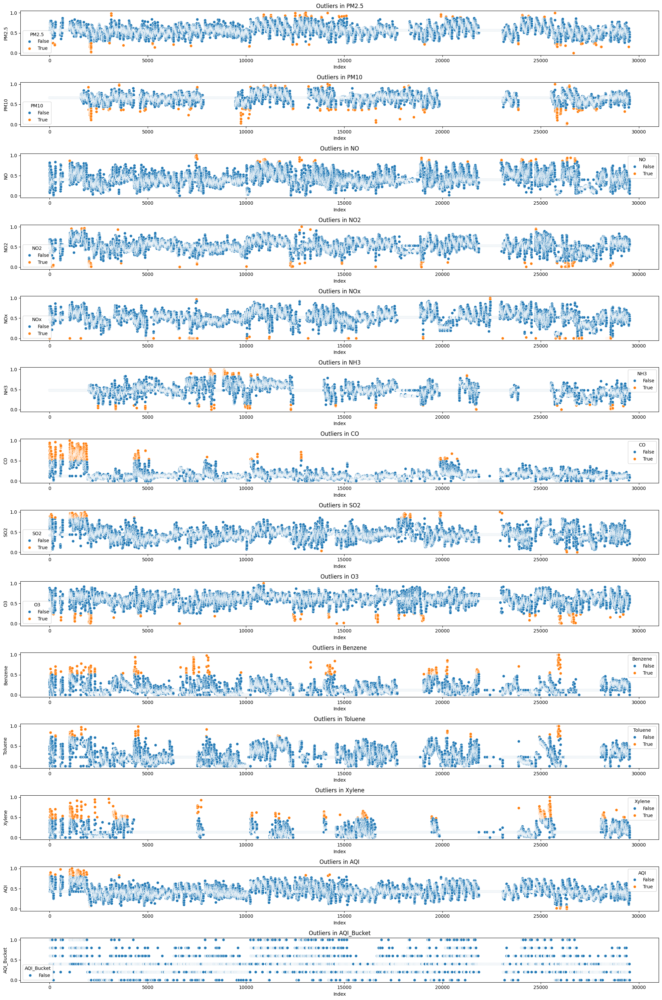

In [113]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from scipy.stats import zscore


columns_to_inspect = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI', 'AQI_Bucket']

# # Calculate the z-scores for each feature
z_scores = df_minmax_scaled[columns_to_inspect].apply(zscore)

# # Define a threshold for identifying outliers
threshold = 3

# # Identify outliers
outliers = (z_scores.abs() > threshold)

# # Display the outliers
print("Outliers based on Z-Score Method:")
print(outliers)

# # Plotting
plt.figure(figsize=(20, 30))

for i, column in enumerate(columns_to_inspect):
    plt.subplot(len(columns_to_inspect), 1, i + 1)
    sns.scatterplot(data=df_minmax_scaled, x=df_minmax_scaled.index, y=column, hue=outliers[column])
    plt.title(f'Outliers in {column}')
    plt.xlabel('Index')
    plt.ylabel(column)

plt.tight_layout()
plt.show()


SCATTER PLOT OF ALL POLLUTANT COLUMNS AFTER NORMALIZING THE 'df_logtransform' DATA

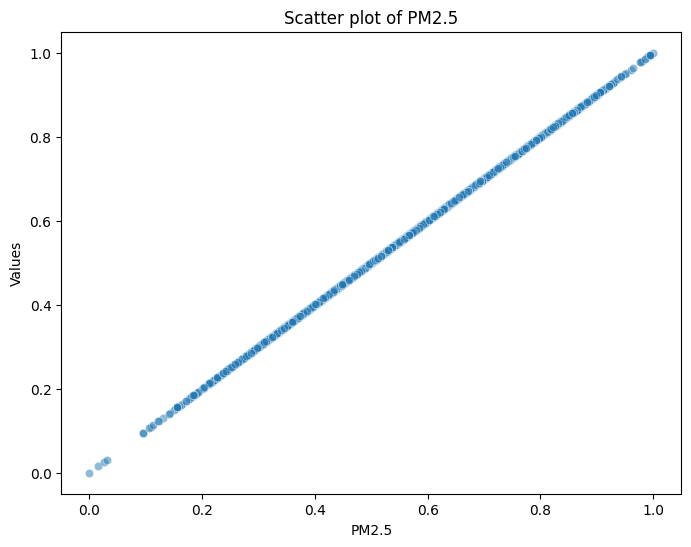

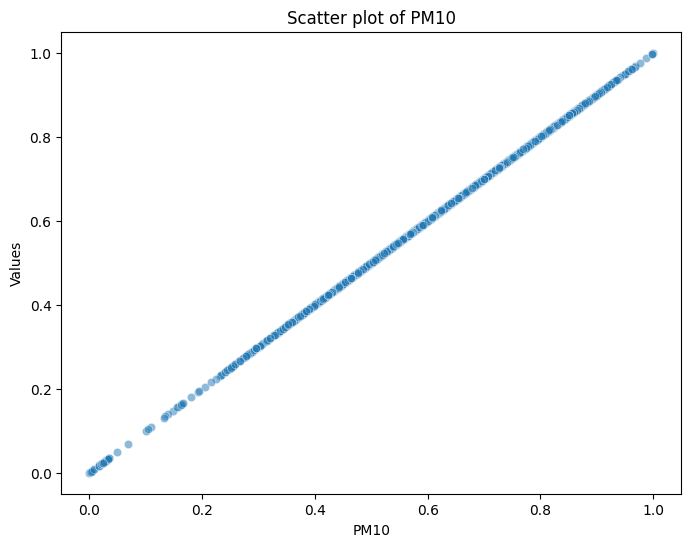

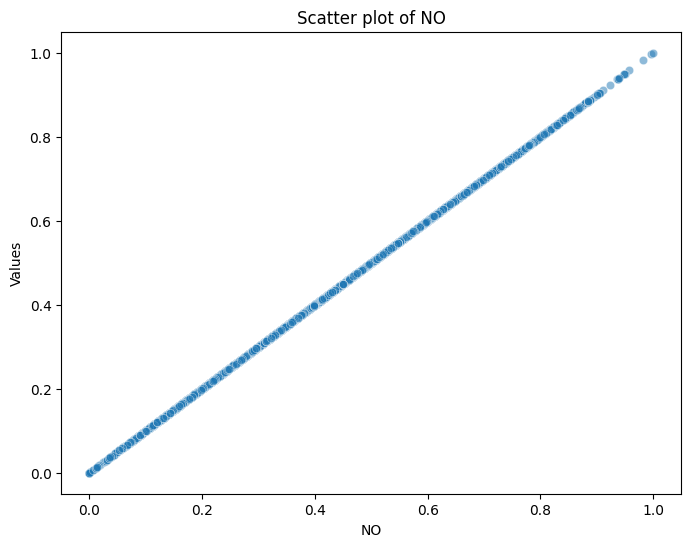

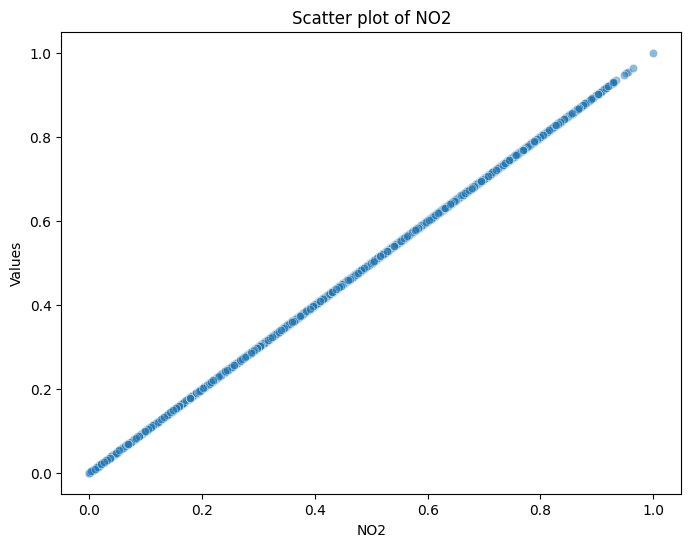

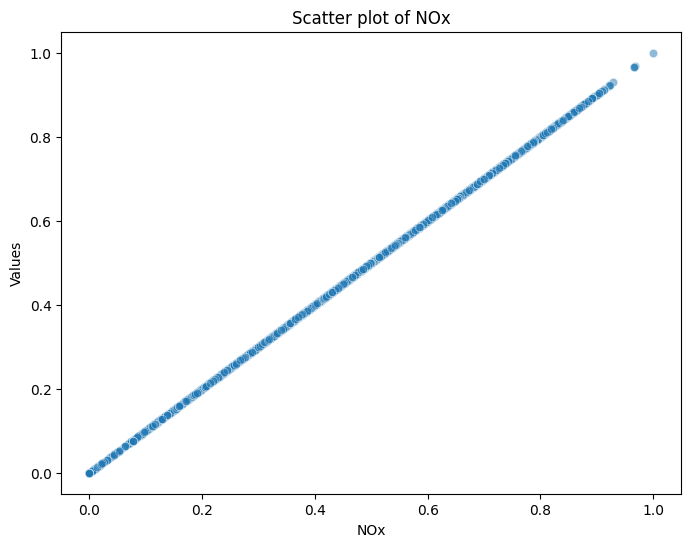

...

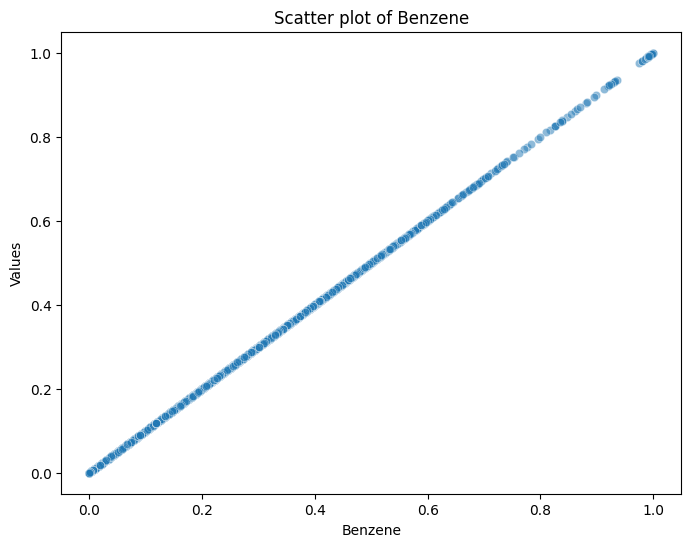

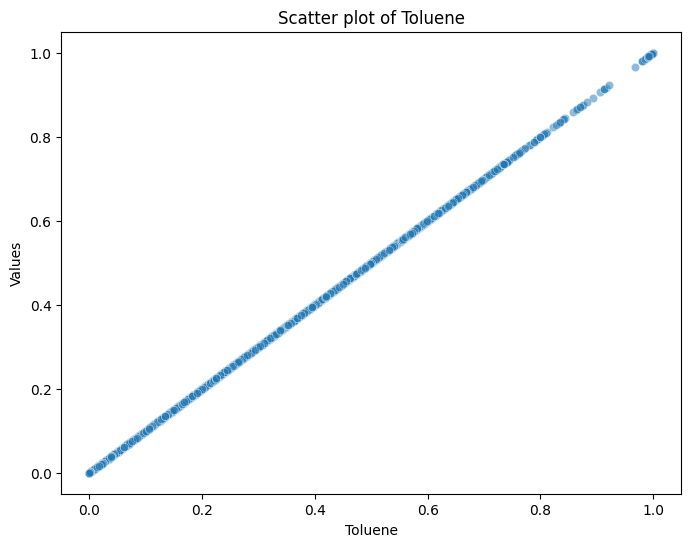

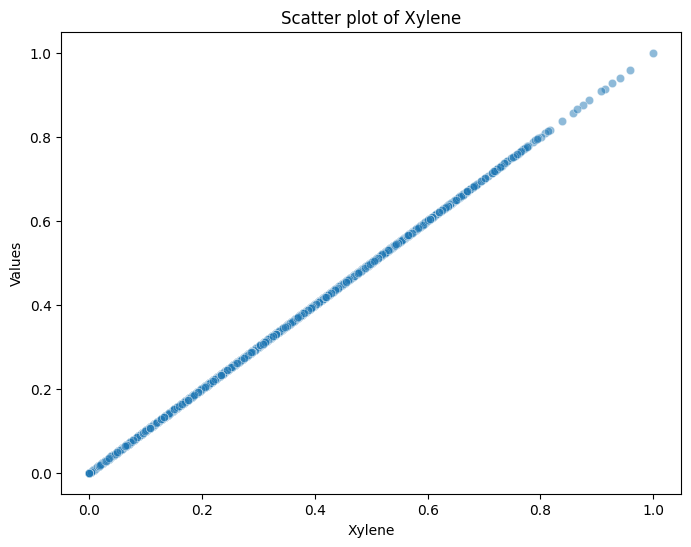

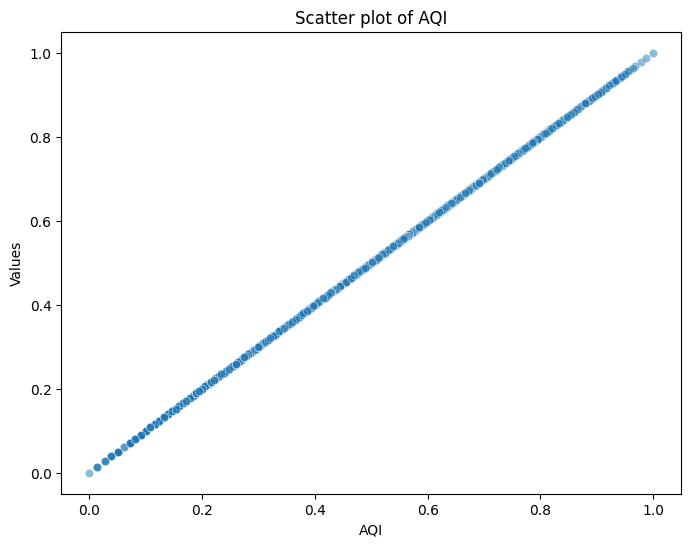

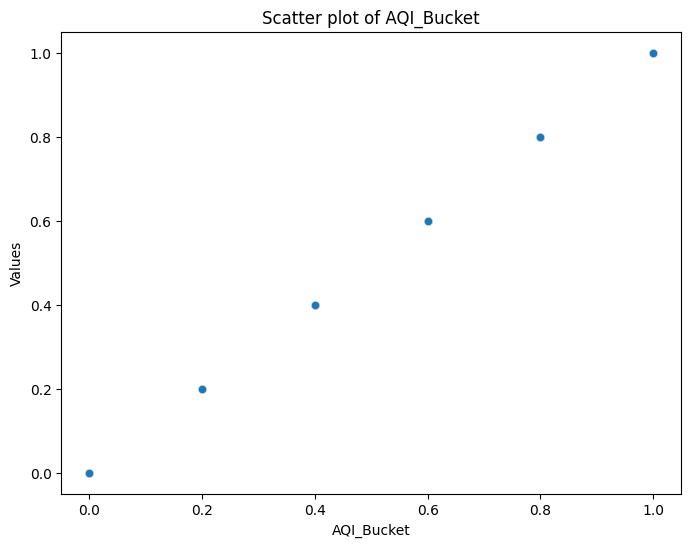

In [114]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot scatter plots for each numeric column
for column in df_minmax_scaled.columns:
    if df_minmax_scaled[column].dtype in ['float64', 'int64']:
        plt.figure(figsize=(8, 6))
        sns.scatterplot(data=df_minmax_scaled, x=column, y=df_minmax_scaled[column], alpha=0.5)
        plt.title(f'Scatter plot of {column}')
        plt.xlabel(column)
        plt.ylabel('Values')
        plt.show()


CORRELATION MATRIX OF ALL POLLUTANT FEATURES

In [115]:
import pandas as pd


# Define the columns you want to include in the correlation analysis
columns_to_correlate = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene', 'AQI', 'AQI_Bucket']

# Calculate the correlation matrix
correlation_matrix = df_minmax_scaled[columns_to_correlate].corr()

# Display the correlation matrix
print("Correlation Matrix:")
correlation_matrix


Correlation Matrix:


,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI,AQI_Bucket
PM2.5,1.000000,0.677246,0.444051,0.441388,0.372125,0.308446,0.239918,0.246893,0.246453,0.188815,0.239101,0.134998,0.791353,0.761786
PM10,0.677246,1.000000,0.426636,0.417915,0.362976,0.308411,0.153879,0.277743,0.237984,0.198206,0.238438,0.084053,0.630454,0.571076
NO,0.444051,0.426636,1.000000,0.476813,0.640239,0.308170,0.282349,0.317858,-0.057991,0.239827,0.233441,0.176541,0.488596,0.481571
NO2,0.441388,0.417915,0.476813,1.000000,0.505152,0.379152,0.265964,0.269297,0.328637,0.254600,0.343343,0.190533,0.466398,0.433931
NOx,0.372125,0.362976,0.640239,0.505152,1.000000,0.248793,0.249185,0.283350,0.028190,0.231140,0.278990,0.167067,0.405340,0.382112
NH3,0.308446,0.308411,0.308170,0.379152,0.248793,1.000000,0.095595,0.043220,0.150108,0.095813,0.098183,-0.026463,0.262280,0.239706
CO,0.239918,0.153879,0.282349,0.265964,0.249185,0.095595,1.000000,0.384988,0.021142,0.268770,0.401021,0.260931,0.542678,0.527067
SO2,0.246893,0.277743,0.317858,0.269297,0.283350,0.043220,0.384988,1.000000,0.157295,0.167194,0.305391,0.249440,0.401969,0.389006
O3,0.246453,0.237984,-0.057991,0.328637,0.028190,0.150108,0.021142,0.157295,1.000000,0.092791,0.178144,0.068898,0.235718,0.196630
Benzene,0.188815,0.198206,0.239827,0.254600,0.231140,0.095813,0.268770,0.167194,0.092791,1.000000,0.695970,0.491004,0.236318,0.227680


FEATURE SELECTION USING CORRELATION ABOVE THRESHOLD VALUE OF 0.4

In [120]:
# Create a copy of the DataFrame 'df_standard_scalar'
df_selected_features = df_minmax_scaled.copy()

# Drop the 'AQI_Bucket' column
df_selected_features = df_selected_features.drop('AQI_Bucket', axis=1)

# Select only the numeric columns for correlation analysis
numeric_columns = df_selected_features.select_dtypes(include=[np.number]).columns

# Calculate the correlation matrix between 'AQI' and other pollutants
correlation_matrix = df_selected_features[numeric_columns].corr()['AQI']

# Select features with correlation above the threshold value of 0.4
significant_features = correlation_matrix[abs(correlation_matrix) > 0.4].index

# Filter the DataFrame to include only significant features
df_selected_features = df_selected_features[significant_features]

# Display the selected features
print("Selected significant features based on correlation with AQI (excluding AQI_Bucket):")
print(df_selected_features.head())

Selected significant features based on correlation with AQI (excluding AQI_Bucket):
      PM2.5      PM10        NO       NO2       NOx        CO       SO2  \
0  0.566736  0.661195  0.106295  0.500592  0.471343  0.126051  0.635622   
1  0.566736  0.661195  0.110615  0.476609  0.465041  0.131019  0.613927   
2  0.566736  0.661195  0.486090  0.509882  0.556808  0.562765  0.644881   
3  0.566736  0.661195  0.163587  0.502876  0.478528  0.191930  0.563452   
4  0.566736  0.661195  0.524318  0.526761  0.594715  0.606722  0.700668   

        AQI  
0  0.429169  
1  0.429169  
2  0.429169  
3  0.429169  
4  0.429169  


In [121]:
df_selected_features

,PM2.5,PM10,NO,NO2,NOx,CO,SO2,AQI
0,0.566736,0.661195,0.106295,0.500592,0.471343,0.126051,0.635622,0.429169
1,0.566736,0.661195,0.110615,0.476609,0.465041,0.131019,0.613927,0.429169
2,0.566736,0.661195,0.486090,0.509882,0.556808,0.562765,0.644881,0.429169
3,0.566736,0.661195,0.163587,0.502876,0.478528,0.191930,0.563452,0.429169
4,0.566736,0.661195,0.524318,0.526761,0.594715,0.606722,0.700668,0.429169
...,...,...,...,...,...,...,...,...
29526,0.401071,0.571134,0.359830,0.552325,0.491458,0.074446,0.426919,0.220316
29527,0.468555,0.624563,0.246417,0.558724,0.465691,0.080909,0.495770,0.325601
29528,0.459804,0.607454,0.247553,0.579225,0.481585,0.075756,0.424315,0.319871
29529,0.415200,0.568401,0.268809,0.577716,0.485491,0.080909,0.450996,0.274394


## Based on the below heatmap, threshold value = 0.5, the top THREE pollutants responsible for increase in AQI are PM2.5, PM10, CO immediately followed by NO.

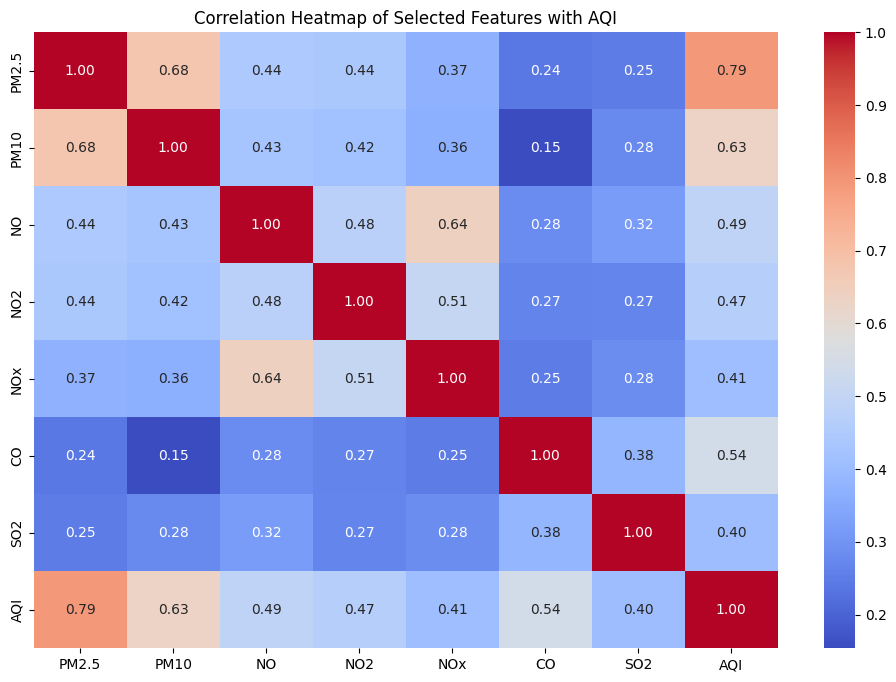

In [123]:
import seaborn as sns
import matplotlib.pyplot as plt

# Create a correlation matrix for the selected features
correlation_matrix_selected = df_selected_features.corr()

# Generate a heatmap
plt.figure(figsize=(12, 8))
sns.heatmap(correlation_matrix_selected, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Heatmap of Selected Features with AQI')
plt.show()

EXACT CORRELATION VALUES OF ALL POLLUTANTS WITH AQI

In [124]:
# Calculate the correlation values of all pollutants with AQI
pollutants = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene']
correlation_values = df_minmax_scaled[pollutants].apply(lambda x: x.corr(df_minmax_scaled['AQI']))

# Display the exact correlation values
print("Exact Correlation Values of Pollutants with AQI:")
correlation_values

Exact Correlation Values of Pollutants with AQI:


PM2.5      0.791353
PM10       0.630454
NO         0.488596
NO2        0.466398
NOx        0.405340
NH3        0.262280
CO         0.542678
SO2        0.401969
O3         0.235718
Benzene    0.236318
Toluene    0.347745
Xylene     0.176847
dtype: float64

In [125]:
df_selected_features.shape

(29531, 8)

KEEPING ONLY THE SELECTED POLLUTANT FEATURES IN A SEPARATE DATAFRAME 'df_feature_selection'

In [126]:
# Create a copy of the DataFrame
df_feature_selection = df_selected_features.copy()

# Drop the 'AQI_Bucket' column
df_feature_selection.drop(columns=['AQI'], inplace=True)

# Display the DataFrame after dropping the column
df_feature_selection.head()


,PM2.5,PM10,NO,NO2,NOx,CO,SO2
0,0.566736,0.661195,0.106295,0.500592,0.471343,0.126051,0.635622
1,0.566736,0.661195,0.110615,0.476609,0.465041,0.131019,0.613927
2,0.566736,0.661195,0.486090,0.509882,0.556808,0.562765,0.644881
3,0.566736,0.661195,0.163587,0.502876,0.478528,0.191930,0.563452
4,0.566736,0.661195,0.524318,0.526761,0.594715,0.606722,0.700668


**EDA**

In [127]:
df_AQI = df_logtransform.copy()

In [128]:
df_AQI_scaled = df_minmax_scaled.copy()

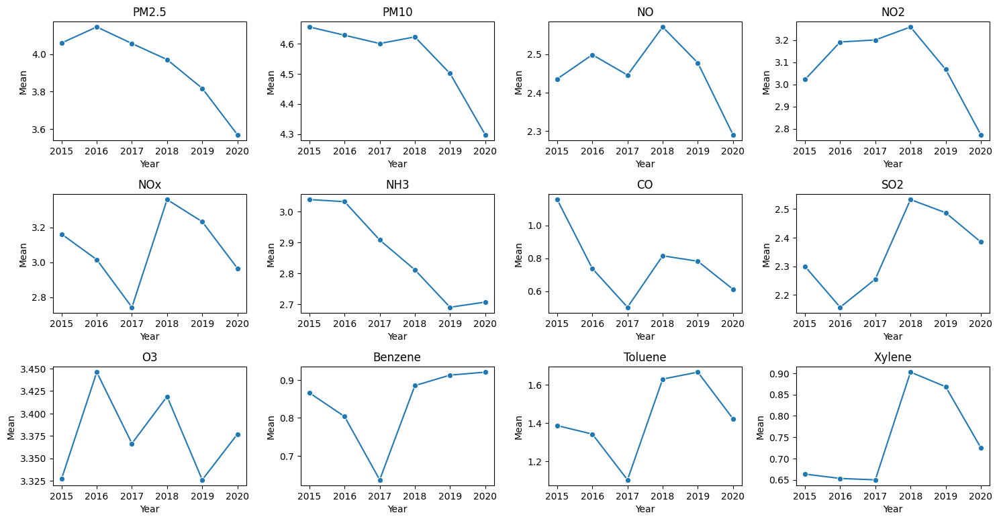

In [131]:
import pandas as pd

# Ensure the Datetime column is in datetime format
df_AQI['Date'] = pd.to_datetime(df_AQI['Date'])

# Extract the year and add it as a separate column
df_AQI['Year'] = df_AQI['Date'].dt.year

# List of pollutant columns (excluding non-pollutant columns)
pollutant_columns = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene']

# Group by year and calculate the mean for each pollutant
yearly_means = df_AQI.groupby('Year')[pollutant_columns].mean().reset_index()

import seaborn as sns
import matplotlib.pyplot as plt

# Set the figure size
plt.figure(figsize=(15, 10))

# Plot line plots for each pollutant
for i, column in enumerate(pollutant_columns, 1):
    plt.subplot(4, 4, i)
    sns.lineplot(data=yearly_means, x='Year', y=column, marker='o')
    plt.title(column)
    plt.xlabel('Year')
    plt.ylabel('Mean')

# Adjust layout
plt.tight_layout()
plt.show()

In [133]:
# import pandas as pd

# # Ensure the Datetime column is in datetime format
# df_AQI_scaled['Date'] = pd.to_datetime(df_AQI_scaled['Date'])

# # Extract the year and add it as a separate column
# df_AQI_scaled['Year'] = df_AQI_scaled['Date'].dt.year

# # List of pollutant columns (excluding non-pollutant columns)
# pollutant_columns = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene']

# # Group by year and calculate the mean for each pollutant
# yearly_means = df_AQI_scaled.groupby('Year')[pollutant_columns].mean().reset_index()

# import seaborn as sns
# import matplotlib.pyplot as plt

# # Set the figure size
# plt.figure(figsize=(15, 10))

# # Plot line plots for each pollutant
# for i, column in enumerate(pollutant_columns, 1):
#     plt.subplot(4, 4, i)
#     sns.lineplot(data=yearly_means, x='Year', y=column, marker='o')
#     plt.title(column)
#     plt.xlabel('Year')
#     plt.ylabel('Mean')

# # Adjust layout
# plt.tight_layout()
# plt.show()

To visualize the six most polluted cities in India from 2015 to 2020 based on the 'df_logtransform' DataFrame, we need to calculate the Mean AQI for Each City, Identify the Top 6 Most Polluted Cities, Visualize the AQI of These Cities Over the Years.

         City       AQI
0   Ahmedabad  0.579138
10      Delhi  0.560250
21      Patna  0.518462
19    Lucknow  0.513840
12   Gurugram  0.512953
23    Talcher  0.459825


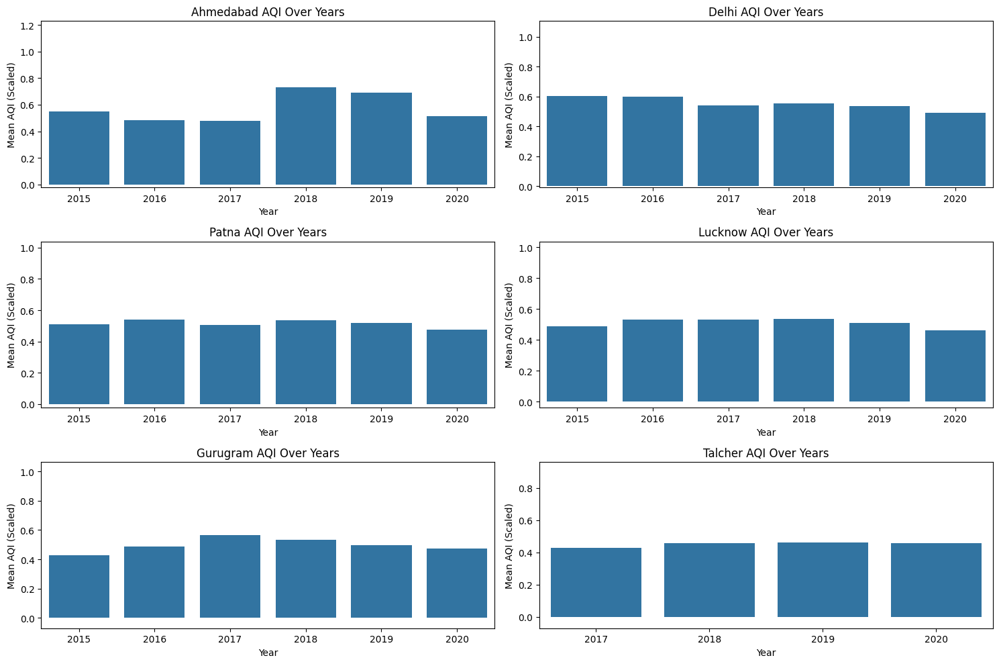

In [136]:
import pandas as pd

# Ensure the Datetime column is in datetime format
df_AQI_scaled['Date'] = pd.to_datetime(df_AQI_scaled['Date'])

# Extract the year and add it as a separate column
df_AQI_scaled['Year'] = df_AQI_scaled['Date'].dt.year

# Calculate the mean AQI for each city over the tenure 2015 - 2020
mean_aqi_per_city = df_AQI_scaled.groupby('City')['AQI'].mean().reset_index()

# Sort the cities by mean AQI in descending order and select the top 5
top_6_polluted_cities = mean_aqi_per_city.sort_values(by='AQI', ascending=False).head(6)
print(top_6_polluted_cities)

import seaborn as sns
import matplotlib.pyplot as plt

# Filter the dataframe for the top 5 most polluted cities
top_cities_data = df_AQI_scaled[df_AQI_scaled['City'].isin(top_6_polluted_cities['City'])]

# Calculate the mean AQI for each year for the top 6 cities
yearly_aqi_top_cities = top_cities_data.groupby(['Year', 'City'])['AQI'].mean().reset_index()

# Set the figure size
plt.figure(figsize=(15, 10))

# Create a bar plot for each of the top 5 polluted cities
for i, city in enumerate(top_6_polluted_cities['City'], 1):
    plt.subplot(3, 2, i)
    city_data = yearly_aqi_top_cities[yearly_aqi_top_cities['City'] == city]
    sns.barplot(data=city_data, x='Year', y='AQI')
    plt.title(f'{city} AQI Over Years')
    plt.xlabel('Year')
    plt.ylabel('Mean AQI (Scaled)')
    plt.ylim(city_data['AQI'].min() - 0.5, city_data['AQI'].max() + 0.5)  # Adjust y-axis for better visualization

# Adjust layout to prevent overlap
plt.tight_layout()
plt.show()


PIE CHART

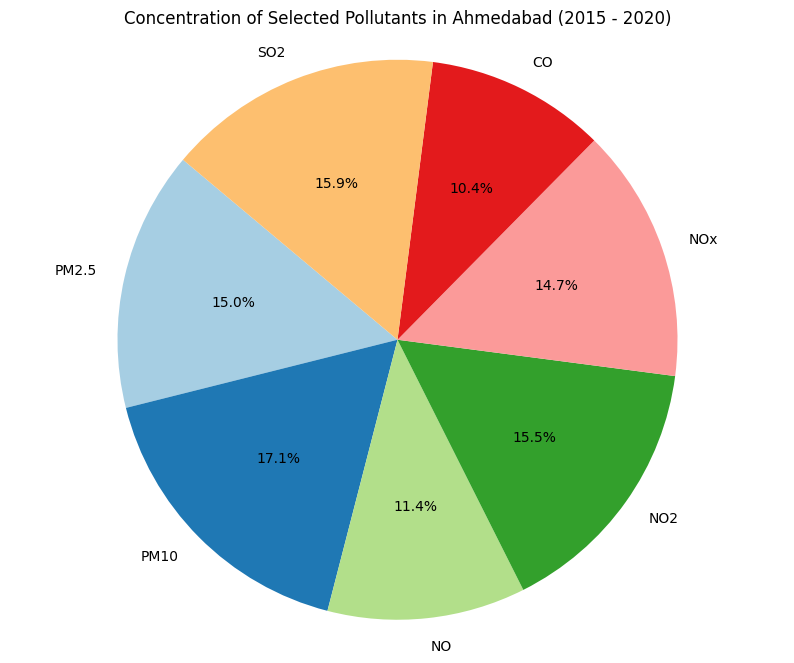

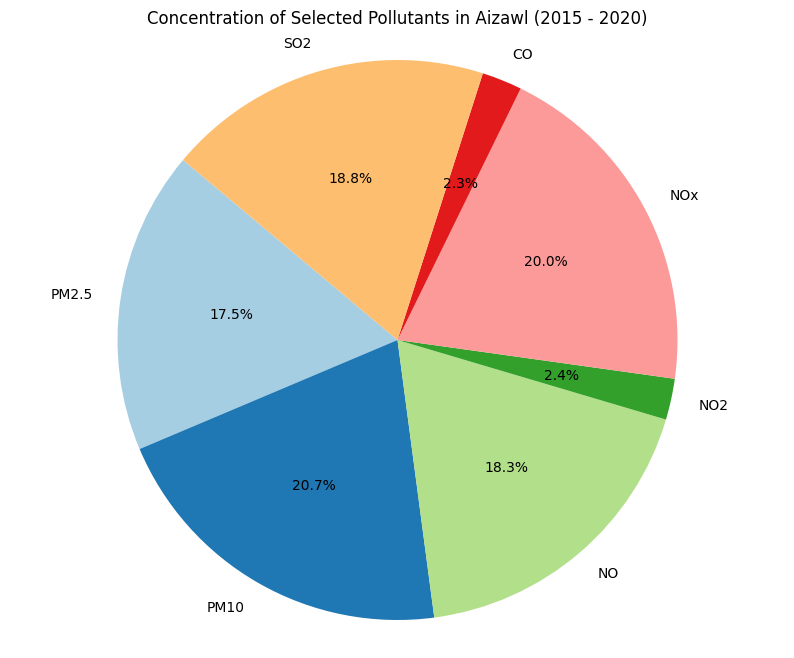

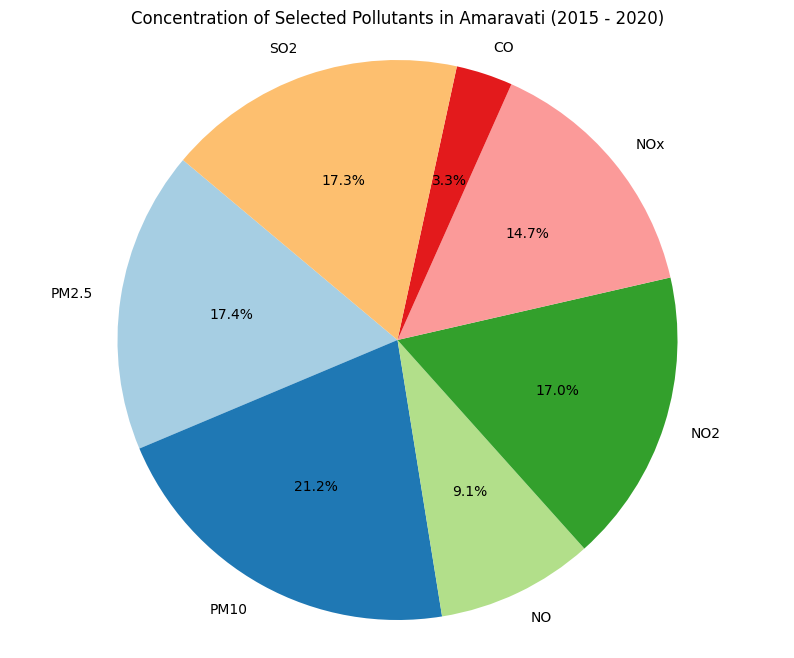

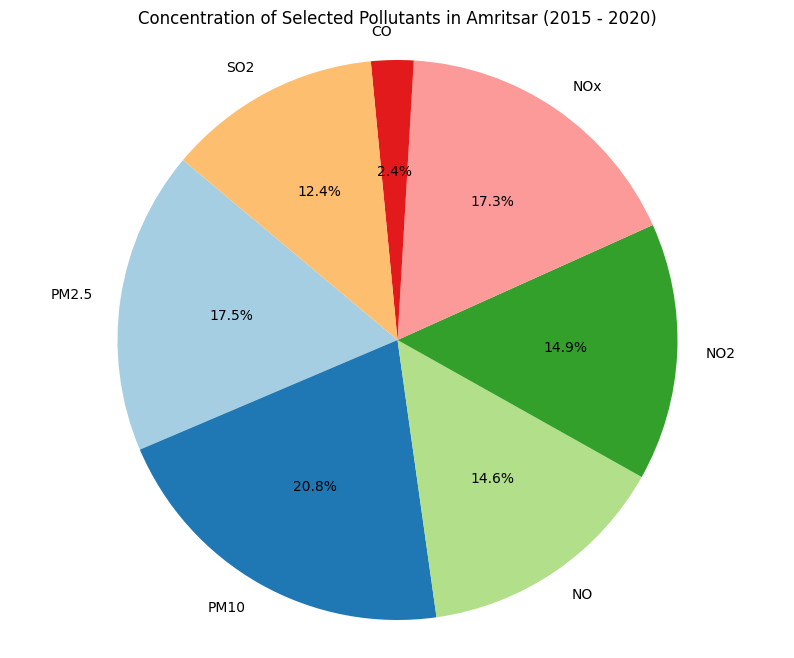

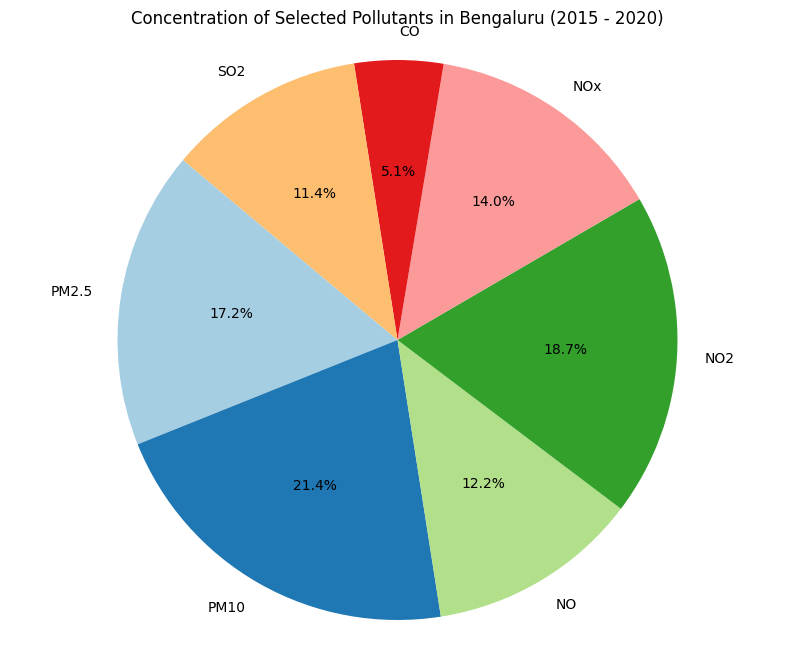

...

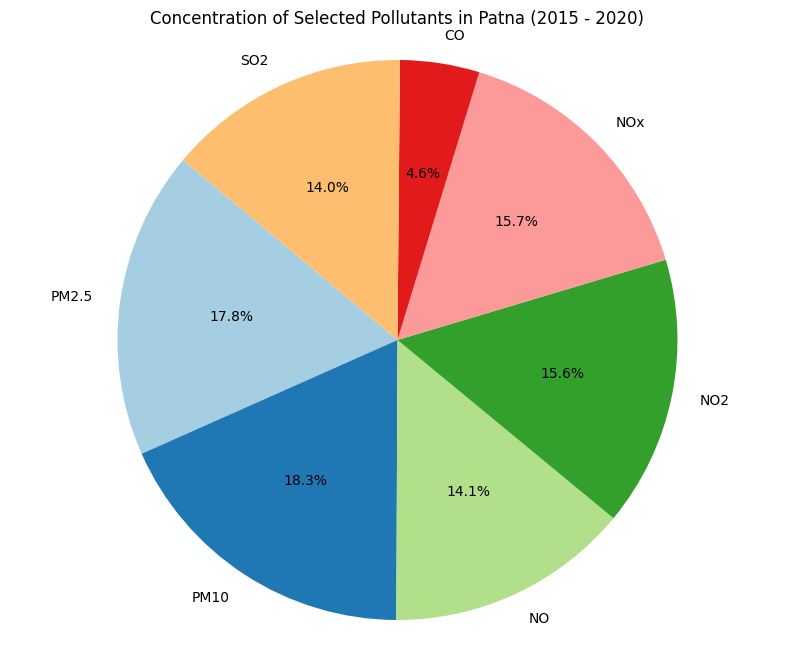

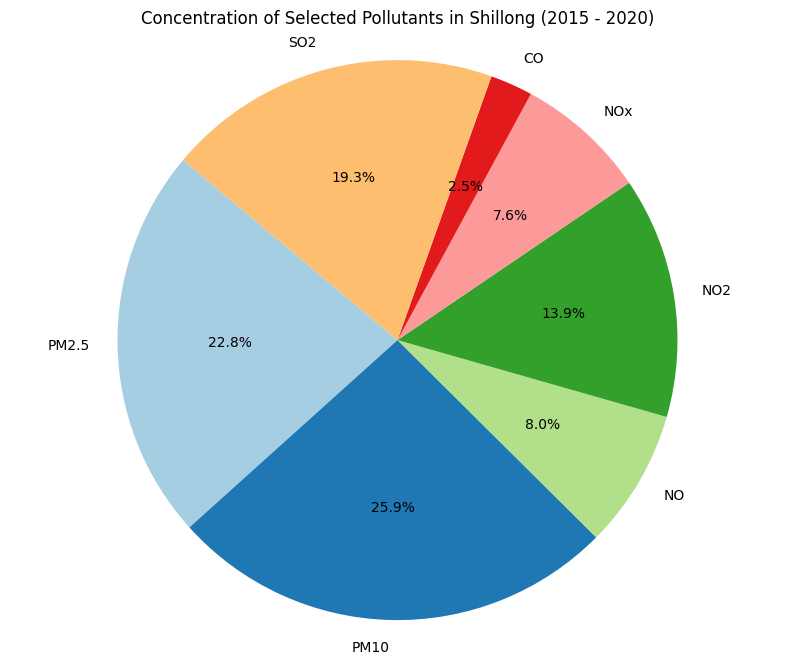

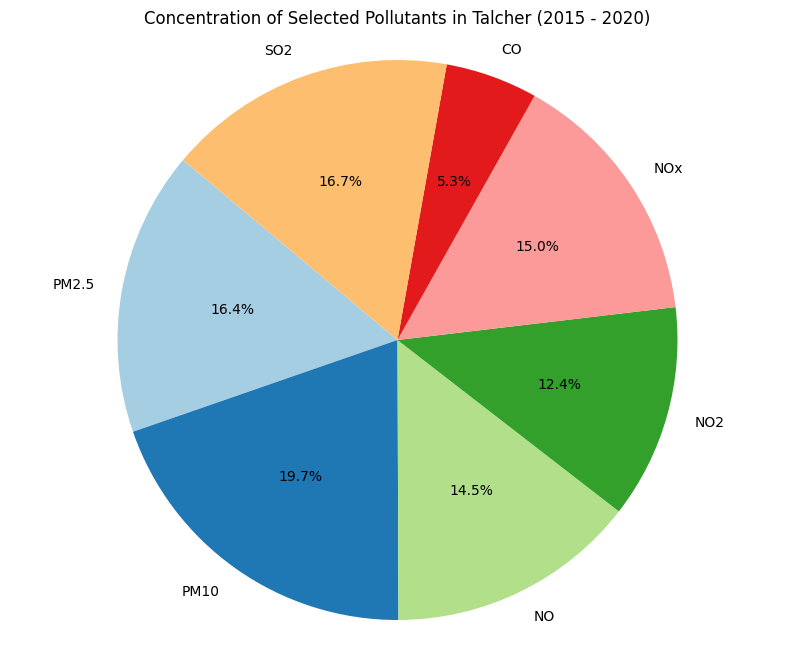

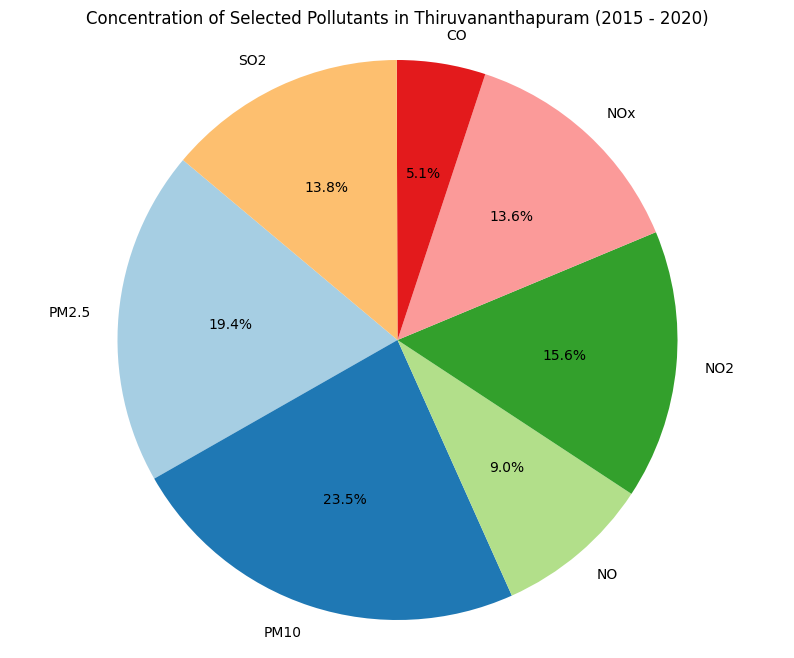

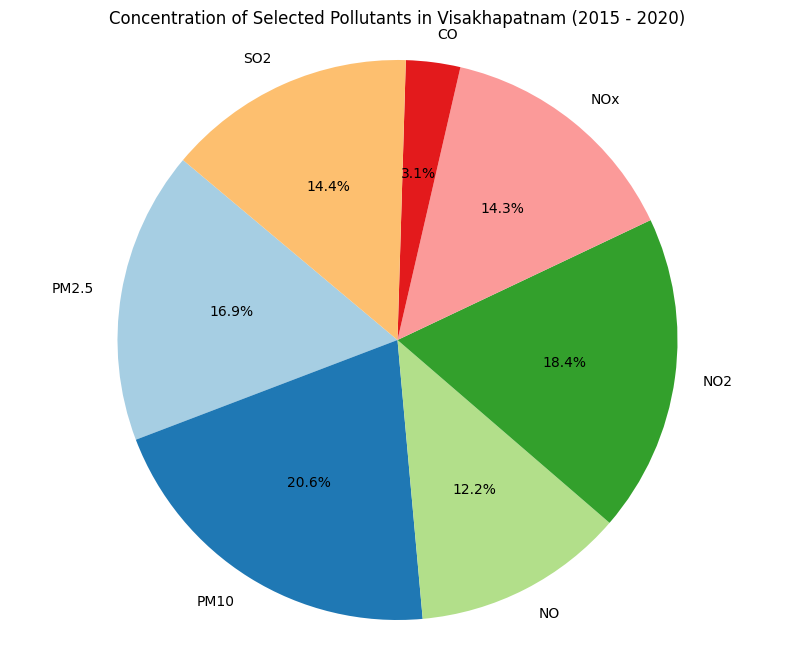

In [139]:
import pandas as pd

# Ensure the Datetime column is in datetime format
df_AQI_scaled['Date'] = pd.to_datetime(df_AQI_scaled['Date'])

# Extract the year and add it as a separate column
df_AQI_scaled['Year'] = df_AQI_scaled['Date'].dt.year

# Filter the data for the years 2015 - 2020
df_filtered = df_AQI_scaled[(df_AQI_scaled['Year'] >= 2015) & (df_AQI_scaled['Year'] <= 2020)]

# Select the pollutant columns (these are the columns after feature selection)
pollutant_columns = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'CO', 'SO2']

# Group by city and sum the concentration of each pollutant
city_pollutant_sums = df_filtered.groupby('City')[pollutant_columns].sum().reset_index()


import matplotlib.pyplot as plt

# Function to plot pie chart for a given city
def plot_city_pollutant_pie(city_data):
    plt.figure(figsize= (10, 8))
    plt.pie(city_data[1:], labels=city_data.index[1:], autopct='%1.1f%%', startangle=140, colors=plt.cm.Paired.colors)
    plt.title(f'Concentration of Selected Pollutants in {city_data[0]} (2015 - 2020)')
    plt.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle.
    plt.show()

# Iterate over each city and plot the pie chart
for index, row in city_pollutant_sums.iterrows():
    plot_city_pollutant_pie(row)


TIMELINE GRAPH

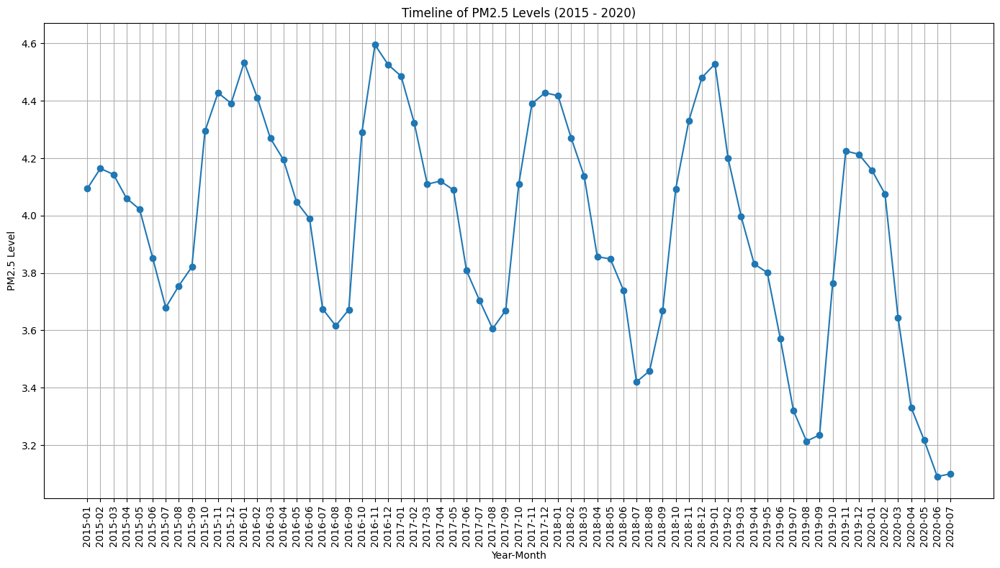

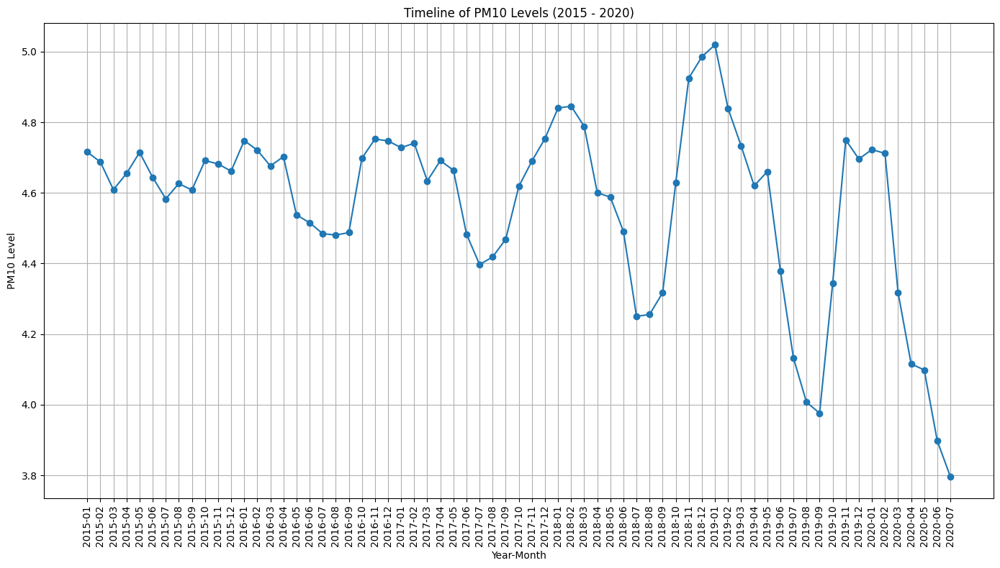

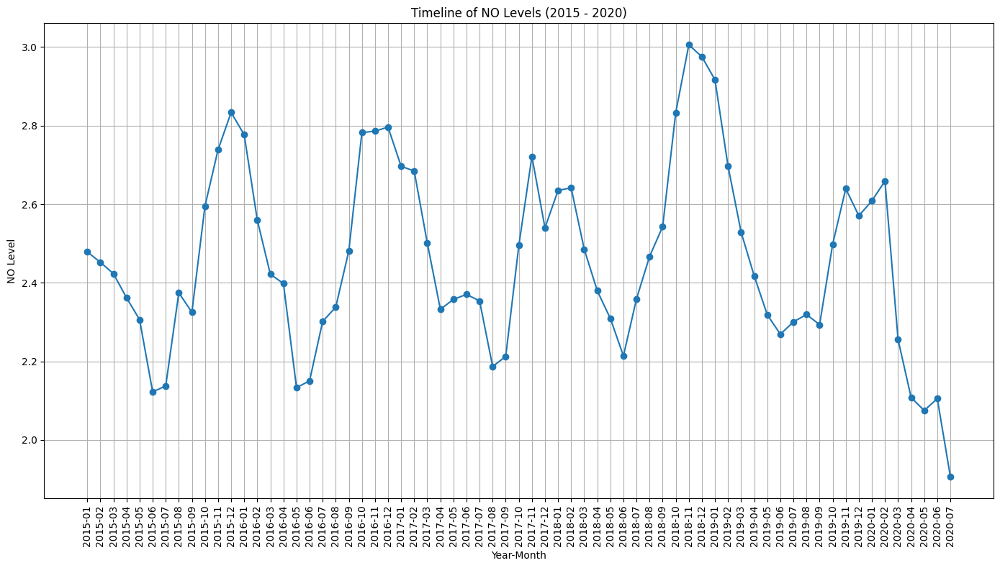

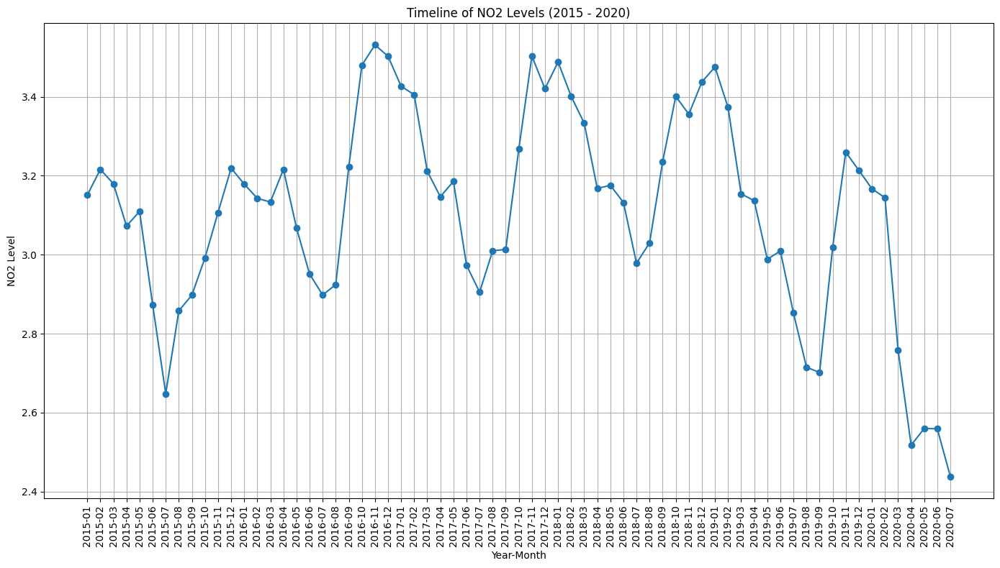

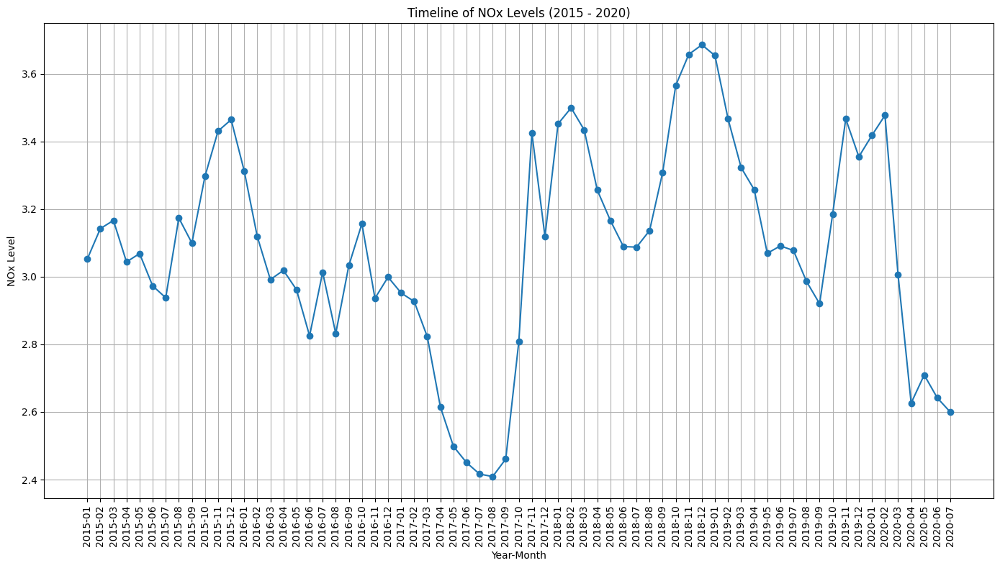

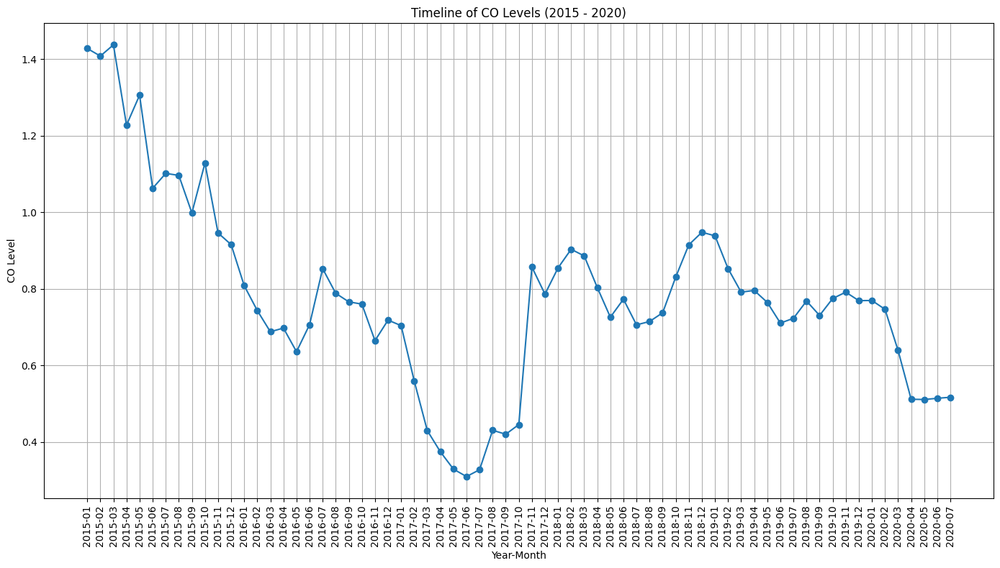

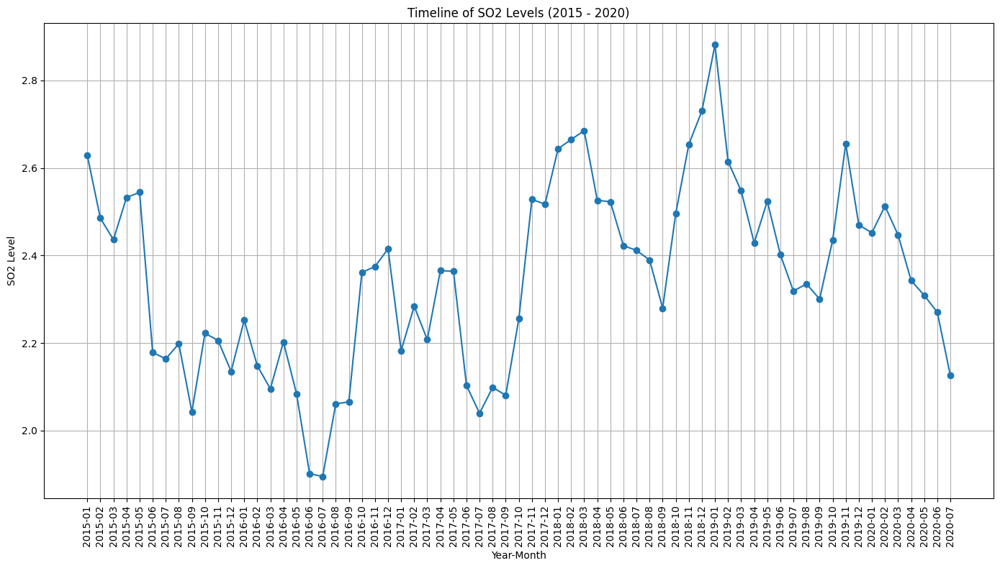

In [141]:
import pandas as pd
import matplotlib.pyplot as plt

# Ensure the Datetime column is in datetime format
df_AQI['Date'] = pd.to_datetime(df_AQI['Date'])

# Extract the year and month and add them as separate columns
df_AQI['Year'] = df_AQI['Date'].dt.year
df_AQI['Month'] = df_AQI['Date'].dt.month

# Filter the data for the years 2015 - 2020
df_filtered = df_AQI[(df_AQI['Year'] >= 2015) & (df_AQI['Year'] <= 2020)].copy()

# Select the relevant columns (assuming these are present in df_feature_selection)
# Include 'Date', 'Year', and 'Month' for plotting purposes
pollutant_columns = df_feature_selection.columns.tolist() + ['Date', 'Year', 'Month']

# Filter the dataframe to include only the relevant columns
df_relevant = df_filtered[pollutant_columns].copy()

# Shift the values in each pollutant column to be positive
for pollutant in df_feature_selection.columns:
    min_value = df_relevant[pollutant].min()
    if min_value < 0:
        df_relevant.loc[:, pollutant] += abs(min_value)

# Function to plot timeline for a given pollutant
def plot_pollutant_timeline(df, pollutant):
    # Create a 'Year-Month' column for grouping
    df['Year-Month'] = df['Date'].dt.to_period('M').astype(str)

    # Group by 'Year-Month' and compute the mean value for the pollutant at each time point
    pollutant_timeline = df.groupby('Year-Month')[pollutant].mean().reset_index()

    # Plot the timeline graph
    plt.figure(figsize=(14, 8))
    plt.plot(pollutant_timeline['Year-Month'], pollutant_timeline[pollutant], marker='o', linestyle='-')
    plt.title(f'Timeline of {pollutant} Levels (2015 - 2020)')
    plt.xlabel('Year-Month')
    plt.ylabel(f'{pollutant} Level')
    plt.xticks(rotation=90)
    plt.grid(True)
    plt.tight_layout()
    plt.show()

# Plot timeline for each selected pollutant
for pollutant in df_feature_selection.columns:
    plot_pollutant_timeline(df_relevant, pollutant)


In [142]:
# import matplotlib.pyplot as plt
# import seaborn as sns

# # Ensure the Datetime column is in datetime format
# df_AQI['Datetime'] = pd.to_datetime(df_AQI['Datetime'])

# # Extract the year and add it as a separate column
# df_AQI['Year'] = df_AQI['Datetime'].dt.year

# # Loop over each pollutant in df_AQI
# for pollutant in df_AQI.columns:
#     if pollutant not in ['Datetime', 'Year', 'City', 'AQI', 'AQI_Bucket', 'Month']:  # Skip non-pollutant columns
#         # Create a box plot for each pollutant over the years 2015-2020
#         plt.figure(figsize=(10, 6))
#         sns.boxplot(x='Year', y=pollutant, data=df_AQI)
#         plt.title(f'Box Plot of {pollutant} Levels (2015 - 2020)')
#         plt.xlabel('Year')
#         plt.ylabel(f'{pollutant} Level')
#         plt.show()


CHECKING WHICH CITIES HAVE AN AQI_Bucket VALUE = 5, OR AQI_Bucket = SEVERE

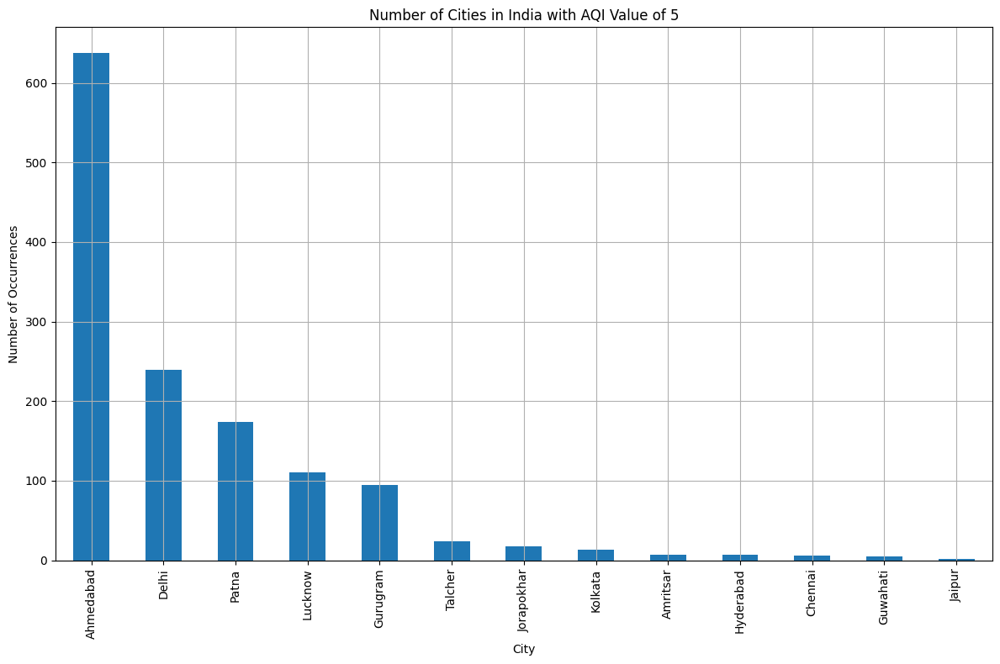

In [143]:
import pandas as pd
import matplotlib.pyplot as plt

# Filter the DataFrame to include only the rows where the AQI value is 5
df_AQI_value_5 = df_AQI[df_AQI['AQI_Bucket'] == 5]

# Count the occurrences of each city with an AQI value of 5
city_counts = df_AQI_value_5['City'].value_counts()

# Create a bar plot to visualize the number of cities with an AQI value of 5
plt.figure(figsize=(12, 8))
city_counts.plot(kind='bar')
plt.title('Number of Cities in India with AQI Value of 5')
plt.xlabel('City')
plt.ylabel('Number of Occurrences')
plt.xticks(rotation=90)
plt.grid(True)
plt.tight_layout()
plt.show()


INTERACTIVE PIE CHART OF AVERAGE READINGS OF ALL POLLUTANTS AGAINST EACH CITY

In [151]:


# List of numeric pollutant columns
numeric_pollutants = ['PM2.5', 'PM10', 'NO', 'NO2', 'NOx', 'NH3', 'CO', 'SO2', 'O3', 'Benzene', 'Toluene', 'Xylene']

# Ensure 'City' is included in the selection
columns_to_include = ['City'] + numeric_pollutants

# Filter the dataframe to include only the relevant columns
df_pollutants = df_AQI[columns_to_include]

# Group by 'City' and calculate the mean of the numeric pollutant columns
avg_readings = df_pollutants.groupby('City').mean().reset_index().round(2)

# Display the first few rows of the resulting dataframe
avg_readings.head()


,City,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene
0,Ahmedabad,4.03,4.59,2.67,3.57,3.51,2.82,2.09,3.27,3.47,1.24,2.34,1.05
1,Aizawl,2.47,2.93,2.24,0.29,2.51,3.12,0.24,2.03,1.46,1.38,1.62,0.68
2,Amaravati,3.45,4.21,1.57,2.87,2.60,2.47,0.48,2.62,3.56,0.27,0.83,0.34
3,Amritsar,3.85,4.60,2.80,2.81,3.41,2.54,0.40,2.09,3.08,1.35,1.25,1.66
4,Bengaluru,3.50,4.38,2.17,3.26,2.54,2.99,0.78,1.78,3.36,0.79,1.21,0.68


PM2.5

In [153]:
pie1=go.Pie(labels=avg_readings['City'], values=avg_readings['PM2.5'].round(2),
             title='Average PM2.5 readings by City')
fig=go.Figure(pie1)
fig.update_traces(textposition='inside')
fig=fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.show()

PM10

In [154]:
pie2=go.Pie(labels=avg_readings['City'], values=avg_readings['PM10'].round(2),
             title='Average PM10 readings by City')
fig=go.Figure(pie2)
fig.update_traces(textposition='inside')
fig=fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.show()

NO, NO2 AND NOx

In [155]:
pie3=go.Pie(labels=avg_readings['City'], values=avg_readings['NO'].round(2),
             title='Average NO readings by City')
fig=go.Figure(pie3)
fig.update_traces(textposition='inside')
fig=fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.show()

pie4=go.Pie(labels=avg_readings['City'], values=avg_readings['NO2'].round(2),
             title='Average NO2 readings by City')
fig=go.Figure(pie4)
fig.update_traces(textposition='inside')
fig=fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.show()

pie5=go.Pie(labels=avg_readings['City'], values=avg_readings['NOx'].round(2),
             title='Average NOx readings by City')
fig=go.Figure(pie5)
fig.update_traces(textposition='inside')
fig=fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.show()

NH3, CO, SO2, O3

In [157]:
pie6=go.Pie(labels=avg_readings['City'], values=avg_readings['NH3'].round(2),
             title='Average NH3 readings by City')
fig=go.Figure(pie6)
fig.update_traces(textposition='inside')
fig=fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.show()

pie7=go.Pie(labels=avg_readings['City'], values=avg_readings['CO'].round(2),
             title='Average CO readings by City')
fig=go.Figure(pie7)
fig.update_traces(textposition='inside')
fig=fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.show()

pie8=go.Pie(labels=avg_readings['City'], values=avg_readings['SO2'].round(2),
             title='Average SO2 readings by City')
fig=go.Figure(pie8)
fig.update_traces(textposition='inside')
fig=fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.show()

pie9=go.Pie(labels=avg_readings['City'], values=avg_readings['O3'].round(2),
             title='Average O3 readings by City')
fig=go.Figure(pie9)
fig.update_traces(textposition='inside')
fig=fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.show()

Benzene, Toluene, Xylene

In [158]:
pie10=go.Pie(labels=avg_readings['City'], values=avg_readings['Benzene'].round(2),
             title='Average Benzene readings by City')
fig=go.Figure(pie10)
fig.update_traces(textposition='inside')
fig=fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.show()

pie11=go.Pie(labels=avg_readings['City'], values=avg_readings['Toluene'].round(2),
             title='Average Toluene readings by City')
fig=go.Figure(pie11)
fig.update_traces(textposition='inside')
fig=fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.show()

pie12=go.Pie(labels=avg_readings['City'], values=avg_readings['Xylene'].round(2),
             title='Average Xylene readings by City')
fig=go.Figure(pie12)
fig.update_traces(textposition='inside')
fig=fig.update_layout(uniformtext_minsize=12, uniformtext_mode='hide')
fig.show()

## EDA Completed till here -----



In [ ]:
predictor_cols = ['PM2.5', 'PM10', 'NO2', 'NOx', 'CO'	]
target_col = ['AQI']

In [ ]:
X = outliers_removed_df[predictor_cols]
y = outliers_removed_df[target_col]


In [ ]:
y.tail()

,AQI
707870,0.01376
707871,0.01376
707872,0.01344
707873,0.01344
707874,0.01344


In [ ]:
X.isnull().sum()

PM2.5    0
PM10     0
NO2      0
NOx      0
CO       0
dtype: int64

## Model Training Starts Here WITHOUT SMOTE ----

In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)


NameError: name 'X' is not defined

In [ ]:
import numpy as np
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_squared_log_error

# Simplified SVR model with optimized hyperparameters
model = SVR(kernel='linear', C=1.0)
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Calculate performance metrics for test data
mae = mean_absolute_error(y_test, y_pred)
rmse = np.sqrt(mean_squared_error(y_test, y_pred))
r2 = r2_score(y_test, y_pred)
rmsle = np.sqrt(mean_squared_log_error(y_test, np.abs(y_pred)))  # Ensure predictions are positive

# Print performance metrics for test data
print("MAE:", mae)
print("RMSE:", rmse)
print("R2:", r2)
print("RMSLE:", rmsle)

# Calculate performance metrics for training data
y_train_pred = model.predict(X_train)
mae_train = mean_absolute_error(y_train, y_train_pred)
rmse_train = np.sqrt(mean_squared_error(y_train, y_train_pred))
r2_train = r2_score(y_train, y_train_pred)
rmsle_train = np.sqrt(mean_squared_log_error(y_train, np.abs(y_train_pred)))  # Ensure predictions are positive

# Print performance metrics for training data
print("Training MAE:", mae_train)
print("Training RMSE:", rmse_train)
print("Training R2:", r2_train)
print("Training RMSLE:", rmsle_train)

In [ ]:
import numpy as np
from xgboost import XGBRegressor

# Train the XGBoost regression model
model_xgb = XGBRegressor(n_estimators=100, max_depth=5, learning_rate=0.1)
model_xgb.fit(X_train, y_train)

# Make predictions on the test set
y_pred_xgb = model_xgb.predict(X_test)

# Calculate performance metrics
mae_xgb = mean_absolute_error(y_test, y_pred_xgb)
rmse_xgb = np.sqrt(mean_squared_error(y_test, y_pred_xgb))
rmsle_xgb = np.sqrt(mean_squared_log_error(y_test, y_pred_xgb))
r2_xgb = r2_score(y_test, y_pred_xgb)

# Calculate accuracy, precision, recall and f1-score
y_pred_binary_xgb = (y_pred_xgb > 0.5).astype(int)
accuracy_xgb = accuracy_score(y_test, y_pred_binary_xgb)
precision_xgb = precision_score(y_test, y_pred_binary_xgb)
recall_xgb = recall_score(y_test, y_pred_binary_xgb)
f1_xgb = f1_score(y_test, y_pred_binary_xgb)

# Print performance metrics
print("MAE:", mae_xgb)
print("RMSE:", rmse_xgb)
print("RMSLE:", rmsle_xgb)
print("R2:", r2_xgb)
print("Accuracy:", accuracy_xgb)
print("Precision:", precision_xgb)
print("Recall:", recall_xgb)
print("F1 score:", f1_xgb)

# Calculate performance metrics for training data
y_train_pred_xgb = model_xgb.predict(X_train)
mae_train_xgb = mean_absolute_error(y_train, y_train_pred_xgb)
rmse_train_xgb = np.sqrt(mean_squared_error(y_train, y_train_pred_xgb))
rmsle_train_xgb = np.sqrt(mean_squared_log_error(y_train, y_train_pred_xgb))
r2_train_xgb = r2_score(y_train, y_train_pred_xgb)

# Calculate accuracy, precision, recall and f1-score for training data
y_train_pred_binary_xgb = (y_train_pred_xgb > 0.5).astype(int)
accuracy_train_xgb = accuracy_score(y_train, y_train_pred_binary_xgb)
precision_train_xgb = precision_score(y_train, y_train_pred_binary_xgb)
recall_train_xgb = recall_score(y_train, y_train_pred_binary_xgb)
f1_train_xgb = f1_score(y_train, y_train_pred_binary_xgb)

# Print performance metrics for training data
print("Training MAE:", mae_train_xgb)
print("Training RMSE:", rmse_train_xgb)
print("Training RMSLE:", rmsle_train_xgb)
print("Training R2:", r2_train_xgb)
print("Training Accuracy:", accuracy_train_xgb)
print("Training Precision:", precision_train_xgb)
print("Training Recall:", recall_train_xgb)
print("Training F1 score:", f1_train_xgb)


In [ ]:
import numpy as np
# Train the Random Forest regression model
model_rf = RandomForestRegressor(n_estimators=100, max_depth=5, random_state=42)
model_rf.fit(X_train, y_train)

# Make predictions on the test set
y_pred_rf = model_rf.predict(X_test)

# Calculate performance metrics
mae_rf = mean_absolute_error(y_test, y_pred_rf)
rmse_rf = np.sqrt(mean_squared_error(y_test, y_pred_rf))
rmsle_rf = np.sqrt(mean_squared_log_error(y_test, y_pred_rf))
r2_rf = r2_score(y_test, y_pred_rf)

# Calculate accuracy, precision, recall and f1-score
y_pred_binary_rf = (y_pred_rf > 0.5).astype(int)
accuracy_rf = accuracy_score(y_test, y_pred_binary_rf)
precision_rf = precision_score(y_test, y_pred_binary_rf)
recall_rf = recall_score(y_test, y_pred_binary_rf)
f1_rf = f1_score(y_test, y_pred_binary_rf)

# Print performance metrics
print("MAE:", mae_rf)
print("RMSE:", rmse_rf)
print("RMSLE:", rmsle_rf)
print("R2:", r2_rf)
print("Accuracy:", accuracy_rf)
print("Precision:", precision_rf)
print("Recall:", recall_rf)
print("F1 score:", f1_rf)

# Calculate performance metrics for training data
y_train_pred_rf = model_rf.predict(X_train)
mae_train_rf = mean_absolute_error(y_train, y_train_pred_rf)
rmse_train_rf = np.sqrt(mean_squared_error(y_train, y_train_pred_rf))
rmsle_train_rf = np.sqrt(mean_squared_log_error(y_train, y_train_pred_rf))
r2_train_rf = r2_score(y_train, y_train_pred_rf)

# Calculate accuracy, precision, recall and f1-score for training data
y_train_pred_binary_rf = (y_train_pred_rf > 0.5).astype(int)
accuracy_train_rf = accuracy_score(y_train, y_train_pred_binary_rf)
precision_train_rf = precision_score(y_train, y_train_pred_binary_rf)
recall_train_rf = recall_score(y_train, y_train_pred_binary_rf)
f1_train_rf = f1_score(y_train, y_train_pred_binary_rf)

# Print performance metrics for training data
print("Training MAE:", mae_train_rf)
print("Training RMSE:", rmse_train_rf)
print("Training RMSLE:", rmsle_train_rf)
print("Training R2:", r2_train_rf)
print("Training Accuracy:", accuracy_train_rf)
print("Training Precision:", precision_train_rf)
print("Training Recall:", recall_train_rf)
print("Training F1 score:", f1_train_rf)


In [ ]:
import numpy as np
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_squared_log_error

# Train the KNN regression model
model_knn = KNeighborsRegressor(n_neighbors=5)
model_knn.fit(X_train, y_train)

# Make predictions on the test set
y_pred_knn = model_knn.predict(X_test)

# Calculate performance metrics for test data
mae_knn = mean_absolute_error(y_test, y_pred_knn)
rmse_knn = np.sqrt(mean_squared_error(y_test, y_pred_knn))
r2_knn = r2_score(y_test, y_pred_knn)
rmsle_knn = np.sqrt(mean_squared_log_error(y_test, np.abs(y_pred_knn)))  # Ensure predictions are positive

# Print performance metrics for test data
print("MAE:", mae_knn)
print("RMSE:", rmse_knn)
print("R2:", r2_knn)
print("RMSLE:", rmsle_knn)

# Calculate performance metrics for training data
y_train_pred_knn = model_knn.predict(X_train)
mae_train_knn = mean_absolute_error(y_train, y_train_pred_knn)
rmse_train_knn = np.sqrt(mean_squared_error(y_train, y_train_pred_knn))
r2_train_knn = r2_score(y_train, y_train_pred_knn)
rmsle_train_knn = np.sqrt(mean_squared_log_error(y_train, np.abs(y_train_pred_knn)))  # Ensure predictions are positive

# Print performance metrics for training data
print("Training MAE:", mae_train_knn)
print("Training RMSE:", rmse_train_knn)
print("Training R2:", r2_train_knn)
print("Training RMSLE:", rmsle_train_knn)

In [ ]:
import numpy as np
# Import necessary libraries
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, accuracy_score, precision_score, recall_score, f1_score

# Train the Gaussian Naive Bayes regression model
model_gnb = GaussianNB()
model_gnb.fit(X_train, y_train)

# Make predictions on the test set
y_pred_gnb = model_gnb.predict(X_test)

# Calculate performance metrics for test data
mae_gnb = mean_absolute_error(y_test, y_pred_gnb)
rmse_gnb = np.sqrt(mean_squared_error(y_test, y_pred_gnb))
r2_gnb = r2_score(y_test, y_pred_gnb)
rmsle_gnb = np.sqrt(mean_squared_log_error(y_test, np.abs(y_pred_gnb)))  # Ensure predictions are positive

# Print performance metrics for test data
print("MAE:", mae_gnb)
print("RMSE:", rmse_gnb)
print("R2:", r2_gnb)
print("RMSLE:", rmsle_gnb)

# Calculate performance metrics for training data
y_train_pred_gnb = model_gnb.predict(X_train)
mae_train_gnb = mean_absolute_error(y_train, y_train_pred_gnb)
rmse_train_gnb = np.sqrt(mean_squared_error(y_train, y_train_pred_gnb))
r2_train_gnb = r2_score(y_train, y_train_pred_gnb)
rmsle_train_gnb = np.sqrt(mean_squared_log_error(y_train, np.abs(y_train_pred_gnb)))  # Ensure predictions are positive

# Print performance metrics for training data
print("Training MAE:", mae_train_gnb)
print("Training RMSE:", rmse_train_gnb)
print("Training R2:", r2_train_gnb)
print("Training RMSLE:", rmsle_train_gnb)

NOW FOR SMOTE SAMPLING y HAS 'AQI_Bucket'

In [ ]:
X_sm = log_transformed_df.copy()

In [ ]:
X_sm.head()

,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene,AQI
0,0.139793,0.223708,0.000599,0.155513,0.083952,0.139905,0.004444,0.711956,0.189018,0.0,0.0,0.0,0.210117
1,0.139793,0.223708,0.000941,0.119916,0.059479,0.139905,0.006659,0.439682,0.189018,0.0,0.0,0.0,0.210117
2,0.139793,0.223708,0.002737,0.128372,0.081982,0.139905,0.018207,0.402480,0.462924,0.0,0.0,0.0,0.210117
3,0.139793,0.223708,0.012488,0.130788,0.136536,0.139905,0.078671,0.221593,0.879657,0.0,0.0,0.0,0.210117
4,0.139793,0.223708,0.017449,0.110896,0.121837,0.139905,0.108085,0.203936,0.189018,0.0,0.0,0.0,0.210117


In [ ]:
y_sm = df_cleaned['AQI_Bucket']

In [ ]:
y_sm

2         2.0
4         2.0
5         2.0
8         2.0
9         2.0
         ... 
707870    1.0
707871    1.0
707872    0.0
707873    0.0
707874    0.0
Name: AQI_Bucket, Length: 627604, dtype: float64

In [ ]:
from sklearn.model_selection import train_test_split

X_train_sm, X_test_sm, y_train_sm, y_test_sm = train_test_split(X_sm, y_sm, test_size=0.25, random_state=42)


In [ ]:
from imblearn.over_sampling import SMOTE

smote = SMOTE(random_state=42)
X_train_resampled, y_train_resampled = smote.fit_resample(X_train_sm, y_train_sm)

In [ ]:
X_train_resampled.shape


(1366500, 13)

In [ ]:
y_train_resampled.shape

(1366500,)

In [ ]:
X_train_resampled.isnull().sum()

PM2.5      0
PM10       0
NO         0
NO2        0
NOx        0
NH3        0
CO         0
SO2        0
O3         0
Benzene    0
Toluene    0
Xylene     0
AQI        0
dtype: int64

In [ ]:
y_train_resampled = X_train_resampled['AQI']
X_train_resampled = X_train_resampled.drop(columns=['AQI'])

In [ ]:
X_train_resampled

,PM2.5,PM10,NO,NO2,NOx,NH3,CO,SO2,O3,Benzene,Toluene,Xylene
0,0.147565,0.286671,0.027970,0.086978,0.097136,0.095485,0.043580,0.077638,0.473157,0.007276,0.050813,0.019735
1,0.139793,0.223708,0.068001,0.163566,0.157524,0.139905,0.043580,0.112684,0.189018,0.014173,0.059281,0.052873
2,0.106389,0.265741,0.067231,0.196666,0.210865,0.081194,0.037163,0.102305,0.360957,0.006617,0.266651,0.052873
3,0.138046,0.262097,0.506886,0.086494,0.400667,0.487712,0.057344,0.113358,0.021691,0.137197,0.016022,0.069680
4,0.204344,0.367020,0.068001,0.163566,0.157524,0.108957,0.042513,0.054724,0.189018,0.014173,0.059281,0.052873
...,...,...,...,...,...,...,...,...,...,...,...,...
1366495,0.291272,0.619661,0.087362,0.536172,0.494224,0.326900,0.328067,0.267204,0.480904,0.038219,0.252340,0.052873
1366496,0.558115,0.223708,0.025399,0.111469,0.035479,0.139905,0.073617,0.093590,0.101605,0.014173,0.059281,0.052873
1366497,0.212863,0.778775,0.732139,0.799259,0.470441,0.476916,0.021319,0.265389,0.103599,0.029975,0.084283,0.052873
1366498,0.115632,0.223708,0.077287,0.337301,0.113684,0.139905,0.407897,0.933900,0.861861,0.066935,0.739501,0.410656


In [ ]:
y_train_resampled

0          0.190661
1          0.210117
2          0.161479
3          0.184825
4          0.210117
             ...   
1366495    0.801987
1366496    0.788102
1366497    0.915304
1366498    0.805917
1366499    0.826406
Name: AQI, Length: 1366500, dtype: float64

In [ ]:
X_test_resampled, y_test_resampled = smote.fit_resample(X_test_sm, y_test_sm)

In [ ]:
X_test_resampled.shape

(455340, 13)

In [ ]:
y_test_resampled.shape

(455340,)

In [ ]:
y_test_resampled = X_test_resampled['AQI']
X_test_resampled = X_test_resampled.drop(columns=['AQI'])

In [ ]:
import numpy as np
from sklearn.svm import SVR
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_squared_log_error

# Simplified SVR model with optimized hyperparameters
model = SVR(kernel='linear', C=1.0)
model.fit(X_train_resampled, y_train_resampled)

# Make predictions on the test set
y_pred = model.predict(X_test_resampled)

# Calculate performance metrics for test data
mae = mean_absolute_error(y_test_resampled, y_pred)
rmse = np.sqrt(mean_squared_error(y_test_resampled, y_pred))
r2 = r2_score(y_test_resampled, y_pred)
rmsle = np.sqrt(mean_squared_log_error(y_test_resampled, np.abs(y_pred)))  # Ensure predictions are positive

# Print performance metrics for test data
print("MAE:", mae)
print("RMSE:", rmse)
print("R2:", r2)
print("RMSLE:", rmsle)

# Calculate performance metrics for training data
y_train_pred = model.predict(X_train_resampled)
mae_train = mean_absolute_error(y_train_resampled, y_train_pred)
rmse_train = np.sqrt(mean_squared_error(y_train_resampled, y_train_pred))
r2_train = r2_score(y_train_resampled, y_train_pred)
rmsle_train = np.sqrt(mean_squared_log_error(y_train_resampled, np.abs(y_train_pred)))  # Ensure predictions are positive

# Print performance metrics for training data
print("Training MAE:", mae_train)
print("Training RMSE:", rmse_train)
print("Training R2:", r2_train)
print("Training RMSLE:", rmsle_train)

In [ ]:
import numpy as np
from xgboost import XGBRegressor

# Train the XGBoost regression model
model_xgb = XGBRegressor(n_estimators=100, max_depth=5, learning_rate=0.1)
model_xgb.fit(X_train_resampled, y_train_resampled)

# Make predictions on the test set
y_pred_xgb = model_xgb.predict(X_test_resampled)

# Calculate performance metrics
mae_xgb = mean_absolute_error(y_test_resampled, y_pred_xgb)
rmse_xgb = np.sqrt(mean_squared_error(y_test_resampled, y_pred_xgb))
rmsle_xgb = np.sqrt(mean_squared_log_error(y_test_resampled, y_pred_xgb))
r2_xgb = r2_score(y_test_resampled, y_pred_xgb)

# Calculate accuracy, precision, recall and f1-score
y_pred_binary_xgb = (y_pred_xgb > 0.5).astype(int)
accuracy_xgb = accuracy_score(y_test_resampled, y_pred_binary_xgb)
precision_xgb = precision_score(y_test_resampled, y_pred_binary_xgb)
recall_xgb = recall_score(y_test_resampled, y_pred_binary_xgb)
f1_xgb = f1_score(y_test_resampled, y_pred_binary_xgb)

# Print performance metrics
print("MAE:", mae_xgb)
print("RMSE:", rmse_xgb)
print("RMSLE:", rmsle_xgb)
print("R2:", r2_xgb)
print("Accuracy:", accuracy_xgb)
print("Precision:", precision_xgb)
print("Recall:", recall_xgb)
print("F1 score:", f1_xgb)

# Calculate performance metrics for training data
y_train_pred_xgb = model_xgb.predict(X_train_resampled)
mae_train_xgb = mean_absolute_error(y_train_resampled, y_train_pred_xgb)
rmse_train_xgb = np.sqrt(mean_squared_error(y_train_resampled, y_train_pred_xgb))
rmsle_train_xgb = np.sqrt(mean_squared_log_error(y_train_resampled, y_train_pred_xgb))
r2_train_xgb = r2_score(y_train_resampled, y_train_pred_xgb)

# Calculate accuracy, precision, recall and f1-score for training data
y_train_pred_binary_xgb = (y_train_pred_xgb > 0.5).astype(int)
accuracy_train_xgb = accuracy_score(y_train_resampled, y_train_pred_binary_xgb)
precision_train_xgb = precision_score(y_train_resampled, y_train_pred_binary_xgb)
recall_train_xgb = recall_score(y_train_resampled, y_train_pred_binary_xgb)
f1_train_xgb = f1_score(y_train_resampled, y_train_pred_binary_xgb)

# Print performance metrics for training data
print("Training MAE:", mae_train_xgb)
print("Training RMSE:", rmse_train_xgb)
print("Training RMSLE:", rmsle_train_xgb)
print("Training R2:", r2_train_xgb)
print("Training Accuracy:", accuracy_train_xgb)
print("Training Precision:", precision_train_xgb)
print("Training Recall:", recall_train_xgb)
print("Training F1 score:", f1_train_xgb)


In [ ]:
import numpy as np
# Train the Random Forest regression model
model_rf = RandomForestRegressor(n_estimators=100, max_depth=5, random_state=42)
model_rf.fit(X_train_resampled, y_train_resampled)

# Make predictions on the test set
y_pred_rf = model_rf.predict(X_test_resampled)

# Calculate performance metrics
mae_rf = mean_absolute_error(y_test_resampled, y_pred_rf)
rmse_rf = np.sqrt(mean_squared_error(y_test_resampled, y_pred_rf))
rmsle_rf = np.sqrt(mean_squared_log_error(y_test_resampled, y_pred_rf))
r2_rf = r2_score(y_test_resampled, y_pred_rf)

# Calculate accuracy, precision, recall and f1-score
y_pred_binary_rf = (y_pred_rf > 0.5).astype(int)
accuracy_rf = accuracy_score(y_test_resampled, y_pred_binary_rf)
precision_rf = precision_score(y_test_resampled, y_pred_binary_rf)
recall_rf = recall_score(y_test_resampled, y_pred_binary_rf)
f1_rf = f1_score(y_test_resampled, y_pred_binary_rf)

# Print performance metrics
print("MAE:", mae_rf)
print("RMSE:", rmse_rf)
print("RMSLE:", rmsle_rf)
print("R2:", r2_rf)
print("Accuracy:", accuracy_rf)
print("Precision:", precision_rf)
print("Recall:", recall_rf)
print("F1 score:", f1_rf)

# Calculate performance metrics for training data
y_train_pred_rf = model_rf.predict(X_train_resampled)
mae_train_rf = mean_absolute_error(y_train_resampled, y_train_pred_rf)
rmse_train_rf = np.sqrt(mean_squared_error(y_train_resampled, y_train_pred_rf))
rmsle_train_rf = np.sqrt(mean_squared_log_error(y_train_resampled, y_train_pred_rf))
r2_train_rf = r2_score(y_train_resampled, y_train_pred_rf)

# Calculate accuracy, precision, recall and f1-score for training data
y_train_pred_binary_rf = (y_train_pred_rf > 0.5).astype(int)
accuracy_train_rf = accuracy_score(y_train_resampled, y_train_pred_binary_rf)
precision_train_rf = precision_score(y_train_resampled, y_train_pred_binary_rf)
recall_train_rf = recall_score(y_train_resampled, y_train_pred_binary_rf)
f1_train_rf = f1_score(y_train_resampled, y_train_pred_binary_rf)

# Print performance metrics for training data
print("Training MAE:", mae_train_rf)
print("Training RMSE:", rmse_train_rf)
print("Training RMSLE:", rmsle_train_rf)
print("Training R2:", r2_train_rf)
print("Training Accuracy:", accuracy_train_rf)
print("Training Precision:", precision_train_rf)
print("Training Recall:", recall_train_rf)
print("Training F1 score:", f1_train_rf)


In [ ]:
import numpy as np
from sklearn.neighbors import KNeighborsRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score, mean_squared_log_error

# Train the KNN regression model
model_knn = KNeighborsRegressor(n_neighbors=5)
model_knn.fit(X_train_resampled, y_train_resampled)

# Make predictions on the test set
y_pred_knn = model_knn.predict(X_test_resampled)

# Calculate performance metrics for test data
mae_knn = mean_absolute_error(y_test_resampled, y_pred_knn)
rmse_knn = np.sqrt(mean_squared_error(y_test_resampled, y_pred_knn))
r2_knn = r2_score(y_test_resampled, y_pred_knn)
rmsle_knn = np.sqrt(mean_squared_log_error(y_test_resampled, np.abs(y_pred_knn)))  # Ensure predictions are positive

# Print performance metrics for test data
print("MAE:", mae_knn)
print("RMSE:", rmse_knn)
print("R2:", r2_knn)
print("RMSLE:", rmsle_knn)

# Calculate performance metrics for training data
y_train_pred_knn = model_knn.predict(X_train_resampled)
mae_train_knn = mean_absolute_error(y_train_resampled, y_train_pred_knn)
rmse_train_knn = np.sqrt(mean_squared_error(y_train_resampled, y_train_pred_knn))
r2_train_knn = r2_score(y_train_resampled, y_train_pred_knn)
rmsle_train_knn = np.sqrt(mean_squared_log_error(y_train_resampled, np.abs(y_train_pred_knn)))  # Ensure predictions are positive

# Print performance metrics for training data
print("Training MAE:", mae_train_knn)
print("Training RMSE:", rmse_train_knn)
print("Training R2:", r2_train_knn)
print("Training RMSLE:", rmsle_train_knn)

In [ ]:
import numpy as np
# Import necessary libraries
from sklearn.naive_bayes import GaussianNB
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, accuracy_score, precision_score, recall_score, f1_score

# Train the Gaussian Naive Bayes regression model
model_gnb = GaussianNB()
model_gnb.fit(X_train_resampled, y_train_resampled)

# Make predictions on the test set
y_pred_gnb = model_gnb.predict(X_test_resampled)

# Calculate performance metrics for test data
mae_gnb = mean_absolute_error(y_test_resampled, y_pred_gnb)
rmse_gnb = np.sqrt(mean_squared_error(y_test_resampled, y_pred_gnb))
r2_gnb = r2_score(y_test_resampled, y_pred_gnb)
rmsle_gnb = np.sqrt(mean_squared_log_error(y_test_resampled, np.abs(y_pred_gnb)))  # Ensure predictions are positive

# Print performance metrics for test data
print("MAE:", mae_gnb)
print("RMSE:", rmse_gnb)
print("R2:", r2_gnb)
print("RMSLE:", rmsle_gnb)

# Calculate performance metrics for training data
y_train_pred_gnb = model_gnb.predict(X_train_resampled)
mae_train_gnb = mean_absolute_error(y_train_resampled, y_train_pred_gnb)
rmse_train_gnb = np.sqrt(mean_squared_error(y_train_resampled, y_train_pred_gnb))
r2_train_gnb = r2_score(y_train_resampled, y_train_pred_gnb)
rmsle_train_gnb = np.sqrt(mean_squared_log_error(y_train_resampled, np.abs(y_train_pred_gnb)))  # Ensure predictions are positive

# Print performance metrics for training data
print("Training MAE:", mae_train_gnb)
print("Training RMSE:", rmse_train_gnb)
print("Training R2:", r2_train_gnb)
print("Training RMSLE:", rmsle_train_gnb)